# Analyse BlueSeis BSPF Event Analysis - XWT - CWT

In [1]:
import os,sys
import obspy as obs
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

In [2]:
from functions.compute_cross_wavelet_transform import __compute_cross_wavelet_transform
from functions.compute_wavelet_coherencey_transform import __compute_wavelet_coherency_transform

In [3]:
if os.uname().nodename == 'lighthouse':
    root_path = '/home/andbro/'
    data_path = '/home/andbro/kilauea-data/'
    archive_path = '/home/andbro/freenas/'
elif os.uname().nodename == 'kilauea':
    root_path = '/home/brotzer/'
    data_path = '/import/kilauea-data/'
    archive_path = '/import/freenas-ffb-01-data/'

In [4]:
sys.path.append(root_path+"andbro_python/")

from andbro__store_as_pickle import __store_as_pickle
from andbro__savefig import __savefig

## Configurations

In [5]:
config = {}

## BSPF coordinates
config['BSPF_lon'] = -116.455439
config['BSPF_lat'] = 33.610643

##
config['path_to_mseed'] = data_path+"BSPF/data/waveforms/ACC/"

## event selction
config['path_to_data'] = data_path+"BSPF/data/"

## output path for figures
config['output_figs'] = data_path+"BSPF/figures/"


## Load Data

In [6]:
events = obs.read_events(config['path_to_data']+"catalogs/BSPF_catalog_20221001_20230615_all.xml")

triggered = pd.read_pickle(config['path_to_data']+"catalogs/BSPF_catalog_20221001_20230615_triggered.pkl")

event_times = pd.read_pickle(config['path_to_data']+"event_selection_good.pkl")

In [304]:
num = 10

event_time = event_times.origin_time.loc[num]

event = events.filter(f"time >= {event_time}",f"time <= {event_time}")

trig = triggered[triggered.origin == event_time]

## prepare string
event_time_str = event_time.split(".")[0].replace(" ","_").replace("-","").replace(":","")

In [305]:
st = obs.read(config['path_to_mseed']+f"*{event_time_str}*")

st.resample(40).trim(st[0].stats.starttime, st[0].stats.endtime);

st.detrend("linear");

# st.filter("bandpass", freqmin=8.0, freqmax=15, corners=4, zerophase=True);

In [187]:
cut_offs = [
    (70,60), (65,80), (60,100), (60,100), (60,70),
    (60,90), (60,90), (60,90), (62,105), (65,90),
    (62,110), (65,85), (60,105), (63,105), (66,90),
    (60,90), (65,90), (70,95),
]

# st.trim(st[0].stats.starttime+cut_offs[num][0]-10, st[0].stats.endtime-cut_offs[num][1]+10);
st.trim(st[0].stats.starttime+cut_offs[num][0], st[0].stats.endtime-cut_offs[num][1]);

In [188]:
# st.plot(equal_scale=False);

## Cross Wavelet Transform

In [301]:
rot = st.copy().select(station="BSPF")
adr = st.copy().select(station="RPFO", location="in")
# acc = st.copy().select(station="PFO*")

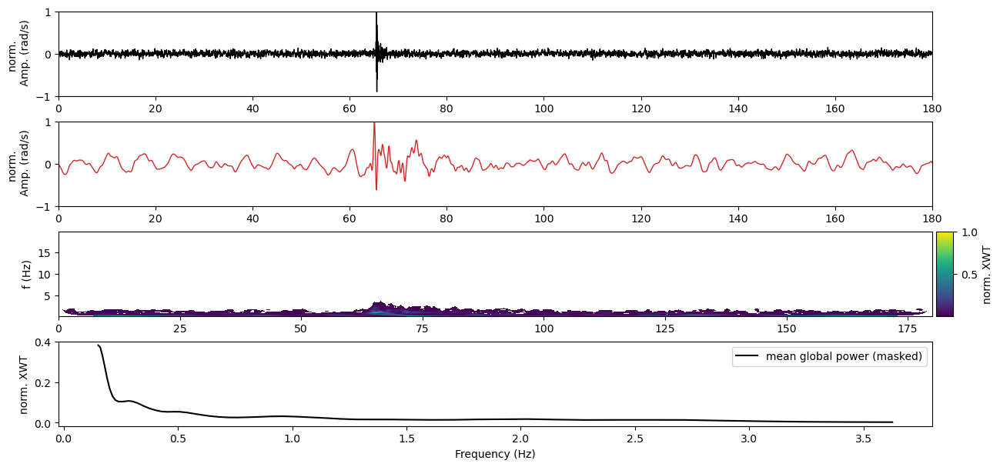

In [294]:
# , vmin=0, vmax=1
comp = "Z"
out = __compute_cross_wavelet_transform(rot.select(channel=f"*{comp}")[0].times(),
                                        rot.select(channel=f"*{comp}")[0].data,
                                        adr.select(channel=f"*{comp}")[0].data,
                                        rot.select(channel=f"*{comp}")[0].stats.delta,
                                        xwt_threshold=0.1,
                                        normalize=True,
                                        plot=True,
                                       )

## Compare inner and all ADR with BSPF

In [317]:
def __makeplot_cwt(st_in, normalize=False, plot=True, decibel=False):

    from matplotlib.gridspec import GridSpec
    from numpy import arange, mean, nan, nanmax, log10
    from pandas import DataFrame
    from functions.get_octave_bands import __get_octave_bands
    from scipy.signal import csd

    colors = {"Z":"tab:red", "N":"tab:green", "E":"blue"}

    ## prepare plots
    if plot:
        NN = 5
        fig = plt.figure(figsize=(15,14))

        gs = GridSpec(NN, 2, figure=fig)

        ax1 = fig.add_subplot(gs[0, :-1])
        ax2 = fig.add_subplot(gs[1, :-1])
        ax3 = fig.add_subplot(gs[2, :-1])

        ax4 = fig.add_subplot(gs[0, 1:])
        ax5 = fig.add_subplot(gs[1, 1:])
        ax6 = fig.add_subplot(gs[2, 1:])

        ax7 = fig.add_subplot(gs[3:, :])

    rot_scale, rot_unit, omega, sqrt_hz = 1e6, r"$\mu$rad/s" , r"$\Omega$", r"$\sqrt{Hz}$"
    xwt_unit = f"{rot_unit}/{sqrt_hz}"

    font = 15

    fmin_i, fmax_i = 1.0, 16.0 ## 0.16, 16.5
    fmin_a, fmax_a = 0.1, 1.0  ## 0.02, 1.3


    for ii, comp in enumerate(["Z","N","E"]):

        tr0 = st_in.select(station="BSPF", channel=f'*{comp}')[0].copy()
        tr1 = st_in.select(station="BSPF", channel=f'*{comp}')[0].copy()
        tr2 = st_in.select(station="RPFO", location="in", channel=f'*{comp}')[0].copy()
        tr3 = st_in.select(station="RPFO", location="al", channel=f'*{comp}')[0].copy()

        tr0 = tr0.detrend("simple").taper(0.1).filter("bandpass", freqmin=fmin_i, freqmax=fmax_i, corners=8, zerophase=True)
        tr1 = tr1.detrend("simple").taper(0.1).filter("bandpass", freqmin=fmin_a, freqmax=fmax_a, corners=8, zerophase=True)
        tr2 = tr2.detrend("simple").taper(0.1).filter("bandpass", freqmin=fmin_i, freqmax=fmax_i, corners=8, zerophase=True)
        tr3 = tr3.detrend("simple").taper(0.1).filter("bandpass", freqmin=fmin_a, freqmax=fmax_a, corners=8, zerophase=True)

        if normalize:
            tr0 = tr0.normalize()
            tr1 = tr1.normalize()
            tr2 = tr2.normalize()
            tr3 = tr3.normalize()
            rot_scale, rot_unit = 1, r"rad/s"

        out = __compute_cross_wavelet_transform(tr0.times(),
                                                tr0.data,
                                                tr2.data,
                                                tr0.stats.delta,
                                                xwt_threshold=0.1,
                                                normalize=False,
                                                plot=False,
                                               )

        ff1, xwt1 = out['frequencies'], out['mean_global_xwt']

        out = __compute_cross_wavelet_transform(tr1.times(),
                                                tr1.data,
                                                tr3.data,
                                                tr1.stats.delta,
                                                xwt_threshold=0.1,
                                                normalize=False,
                                                plot=False,
                                               )

        ff2, xwt2 = out['frequencies'], out['mean_global_xwt']

        ## convert to decibel
        if decibel:
            xwt1 = 10*log10(xwt1)
            xwt2 = 10*log10(xwt2)
            xwt_unit = f"dB rel. to 1 {rot_unit}"

        ## plotting
        if plot:

            adr_inner = r"ADR$_{inner}$"

            if comp == "Z":
                ax1.plot(tr0.times(), tr0.data*rot_scale, color="k", label=f"BSPF-{comp}")
                ax1.plot(tr2.times(), tr2.data*rot_scale, color=colors[comp], label=f"ADR-{comp}", alpha=0.7)

                ax4.plot(tr1.times(), tr1.data*rot_scale, color="k", label=f"BSPF-{comp}")
                ax4.plot(tr3.times(), tr3.data*rot_scale, color=colors[comp], label=f"ADR-{comp}", alpha=0.7)

            elif comp == "N":
                ax2.plot(tr0.times(), tr0.data*rot_scale, color="k", label=f"BSPF-{comp}")
                ax2.plot(tr2.times(), tr2.data*rot_scale, color=colors[comp], label=f"ADR-{comp}", alpha=0.7)

                ax5.plot(tr1.times(), tr1.data*rot_scale, color="k", label=f"BSPF-{comp}")
                ax5.plot(tr3.times(), tr3.data*rot_scale, color=colors[comp], label=f"ADR-{comp}", alpha=0.7)

            elif comp == "E":
                ax3.plot(tr0.times(), tr0.data*rot_scale, color="k", label=f"BSPF-{comp}")
                ax3.plot(tr2.times(), tr2.data*rot_scale,color=colors[comp], label=f"ADR-{comp}", alpha=0.7)

                ax6.plot(tr1.times(), tr1.data*rot_scale, color="k", label=f"BSPF-{comp}")
                ax6.plot(tr3.times(), tr3.data*rot_scale, color=colors[comp], label=f"ADR-{comp}", alpha=0.7)

            for ax in [ax1, ax2, ax3, ax4, ax5, ax6]:
                ax.legend(loc=1, ncol=2)
                ax.set_ylabel(f"{omega} ({rot_unit})", fontsize=font)

            ax7.plot(ff1, xwt1, ls="-", color=colors[comp], label="BSPF-RPFO_inner")

            ax7.plot(ff2, xwt2, ls=":", color=colors[comp], label="BSPF-PRFO_all")

            ax7.legend(ncol=3)

            ax7.set_xscale("log")
            # ax7.set_yscale("log")

            ax7.grid(ls="--",zorder=0,alpha=.5, which="both")

            ax7.set_xlabel("Frequency (Hz)", fontsize=font)
            ax7.set_ylabel(f"Cross Wavelet Transform ({xwt_unit})", fontsize=font)

            ax1.set_title(f"inner array ({fmin_i} - {fmax_i} Hz)", fontsize=font+1)
            ax4.set_title(f"total array ({fmin_a} - {fmax_a} Hz)", fontsize=font+1)


        ## prepare output
        out = {}
        out[f'{comp}_in_ff'] = ff1
        out[f'{comp}_in_xct']  = xwt1
        out[f'{comp}_al_ff'] = ff2
        out[f'{comp}_al_xwt']  = xwt2

    if plot:
        out['fig'] = fig


    plt.show();
    return out

Warning: Cannot place an upperbound on the unbiased AR(1). Series is too short or trend is to large.

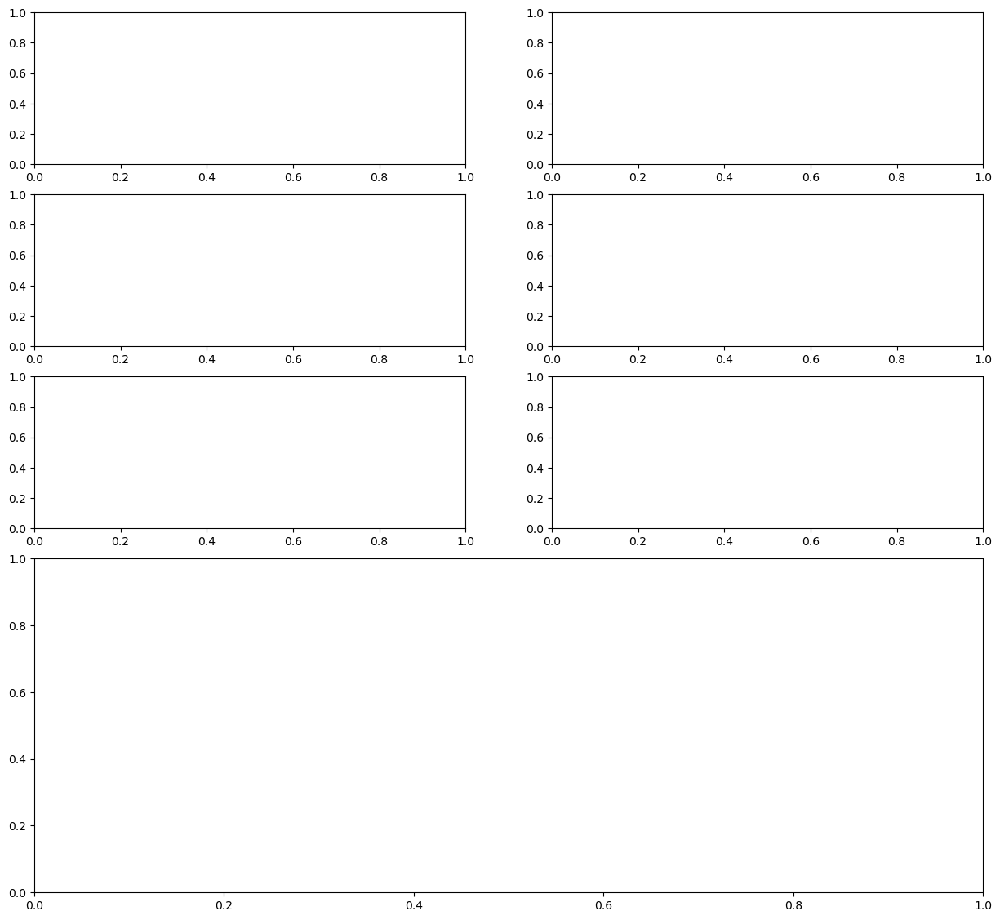

In [319]:
out = __makeplot_cwt(st, normalize=True, plot=True, decibel=True)

## AS LOOP

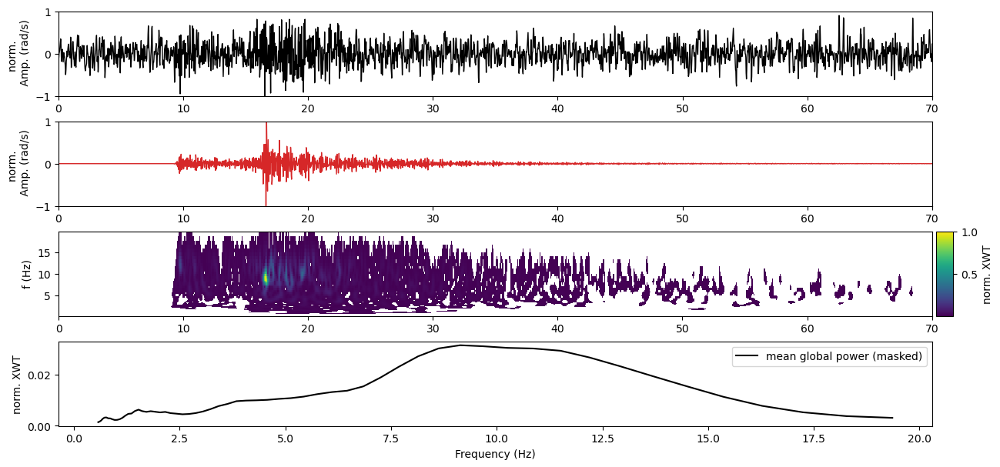


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221003_160809_xwt_Z.png ...

   -> Done



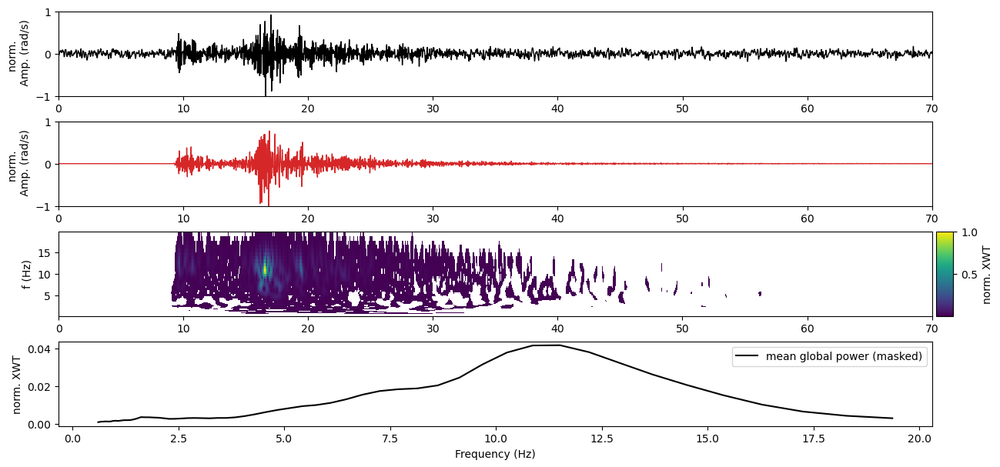


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221003_160809_xwt_N.png ...

   -> Done



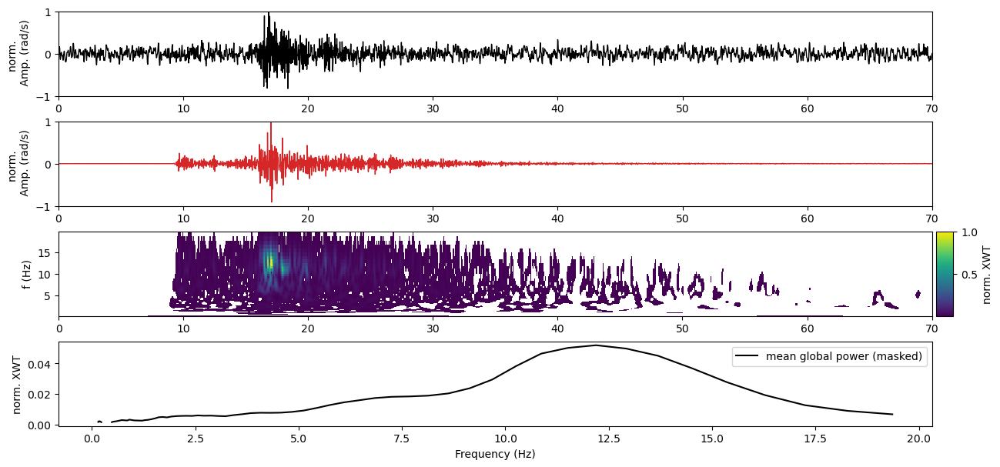


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221003_160809_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.0618347182567268 0.005174599592396822


/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/pycwt/wavelet.py:633: RuntimeWarning: invalid value encountered in arctanh
  aa = numpy.round(numpy.arctanh(numpy.array([al1, al2]) * 4))
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/pycwt/wavelet.py:254: RuntimeWarning: invalid value encountered in log2
  dj = numpy.log2(scales[1] / scales[0])
/home/brotzer/notebooks/BSPF/functions/compute_wavelet_coherencey_transform.py:119: RuntimeWarning: Mean of empty slice
  global_power_t = nan_to_num(nanmean(wct_power_masked,axis=0), nan=0)


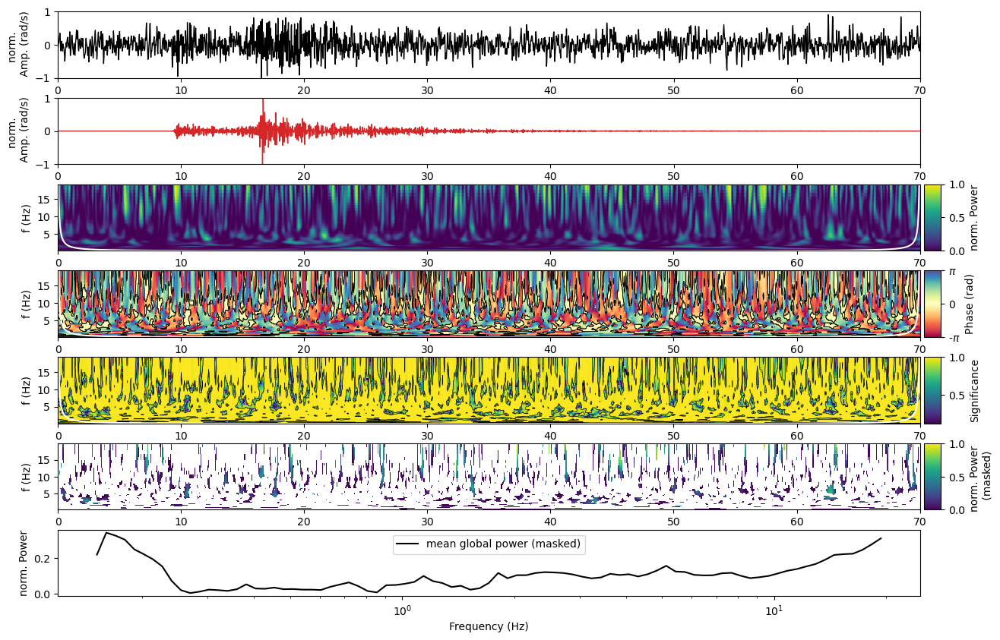


   -> saving /import/kilauea-data/BSPF/figures/wct/20221003_160809_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.011961223160033856 0.007742288687325333


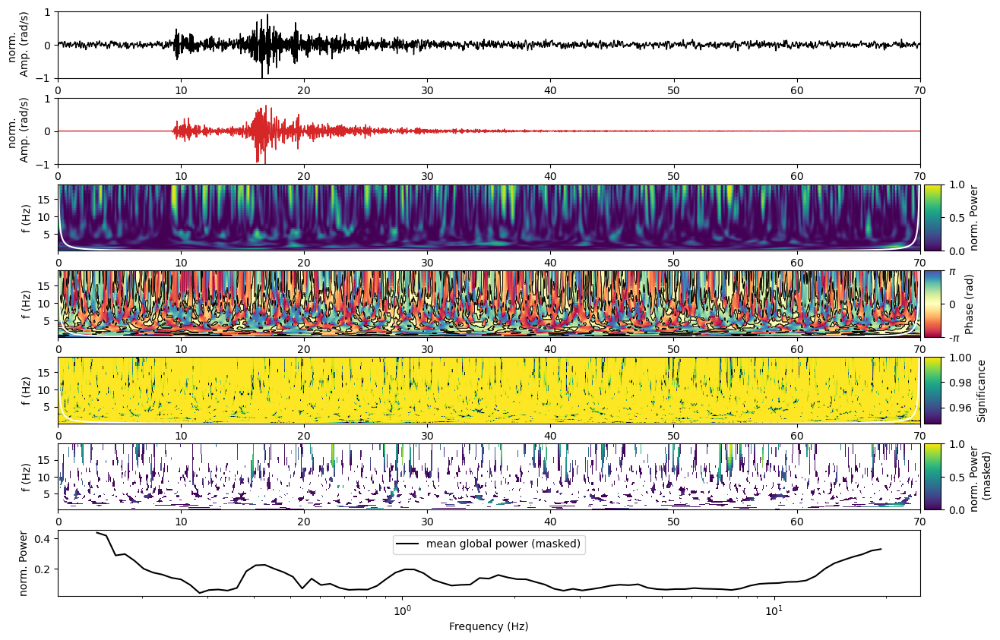


   -> saving /import/kilauea-data/BSPF/figures/wct/20221003_160809_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.016865155583357976 0.0052019217789166985


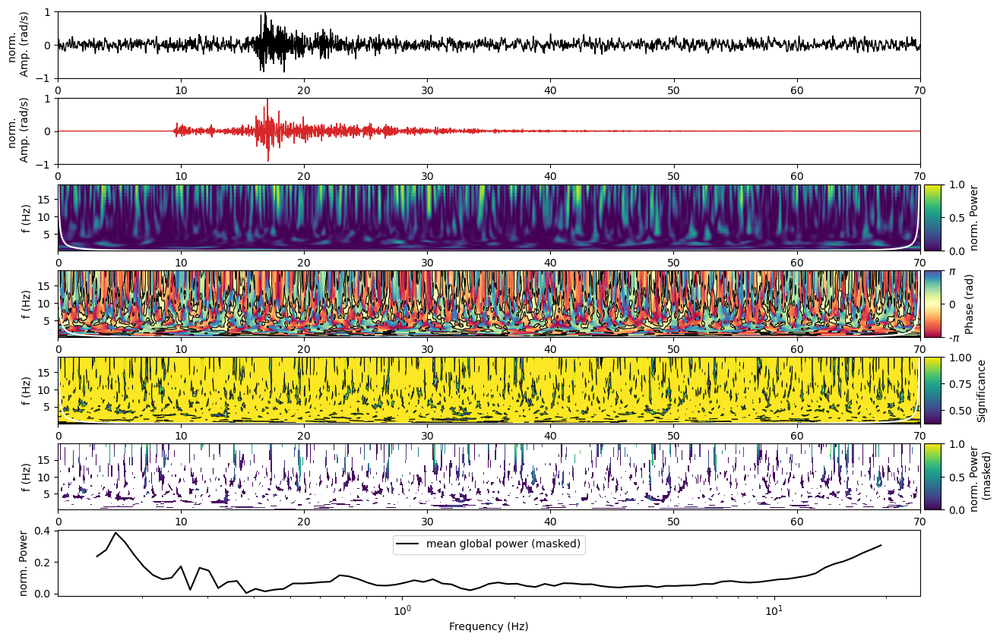


   -> saving /import/kilauea-data/BSPF/figures/wct/20221003_160809_wct_E.png ...

   -> Done



No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


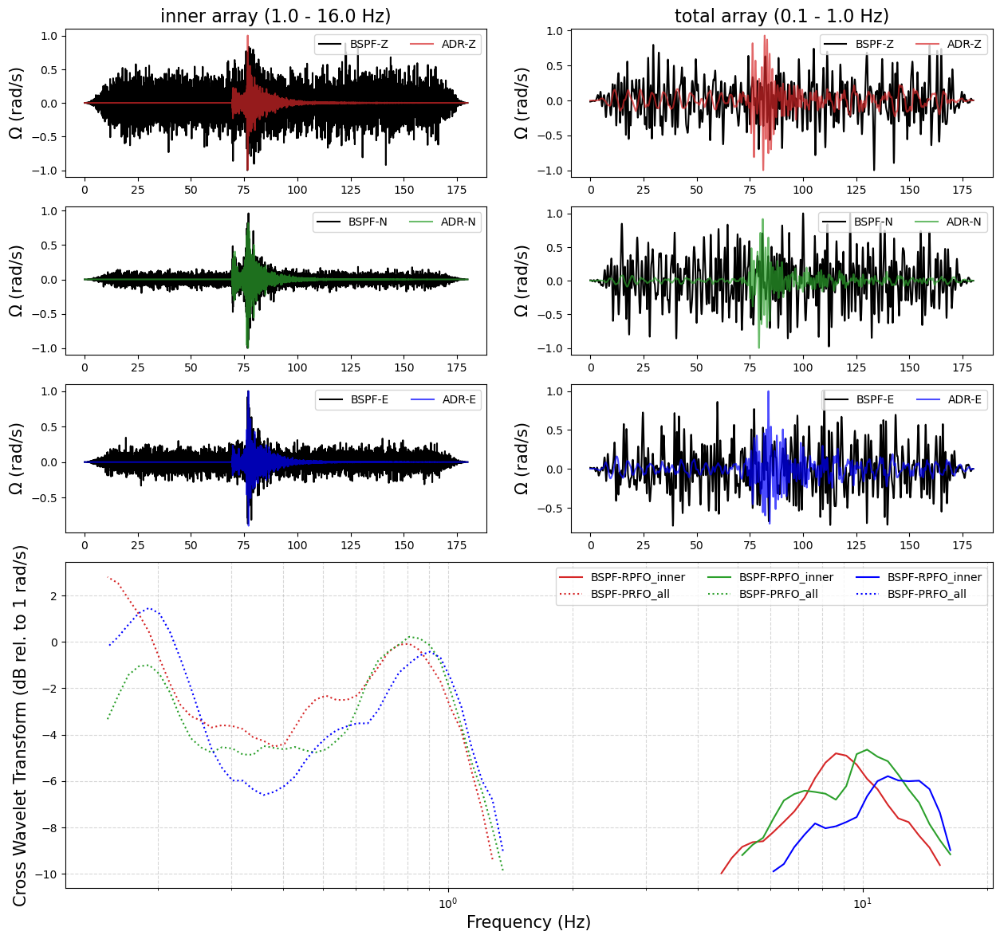


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221003_160809_xwt_comparison.png ...

   -> Done



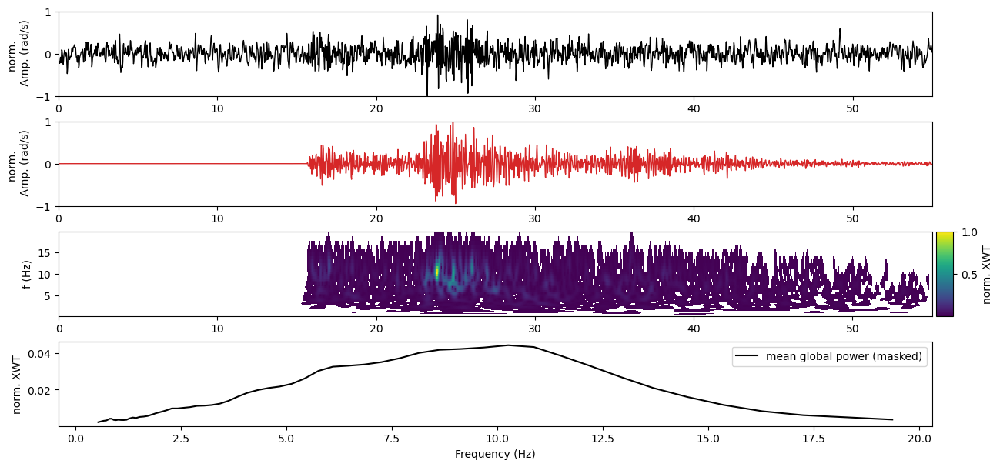


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221007_224505_xwt_Z.png ...

   -> Done



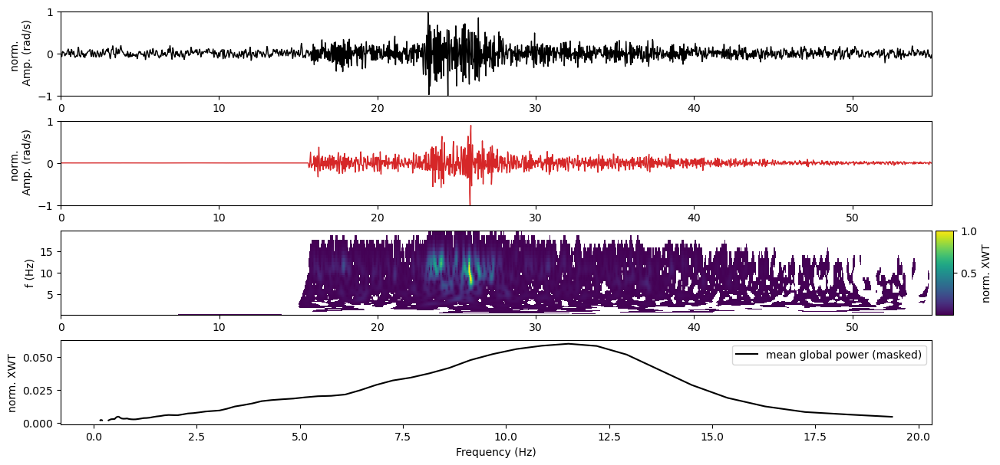


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221007_224505_xwt_N.png ...

   -> Done



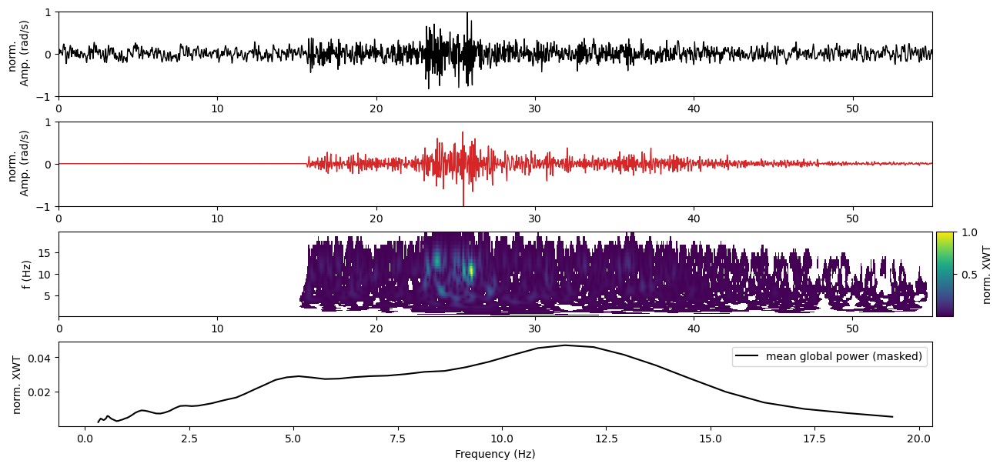


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221007_224505_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.03387233389568868 0.02438998736898628


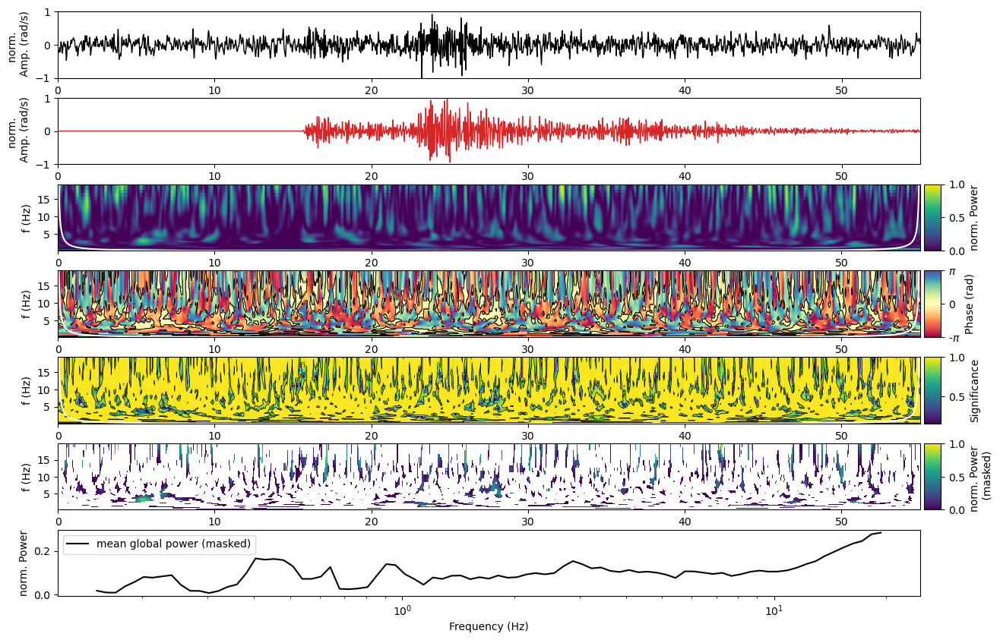


   -> saving /import/kilauea-data/BSPF/figures/wct/20221007_224505_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.02117544738289046 0.010180201455753232


/home/brotzer/notebooks/BSPF/functions/compute_wavelet_coherencey_transform.py:118: RuntimeWarning: Mean of empty slice
  global_power_f = nan_to_num(nanmean(wct_power_masked,axis=1), nan=0)


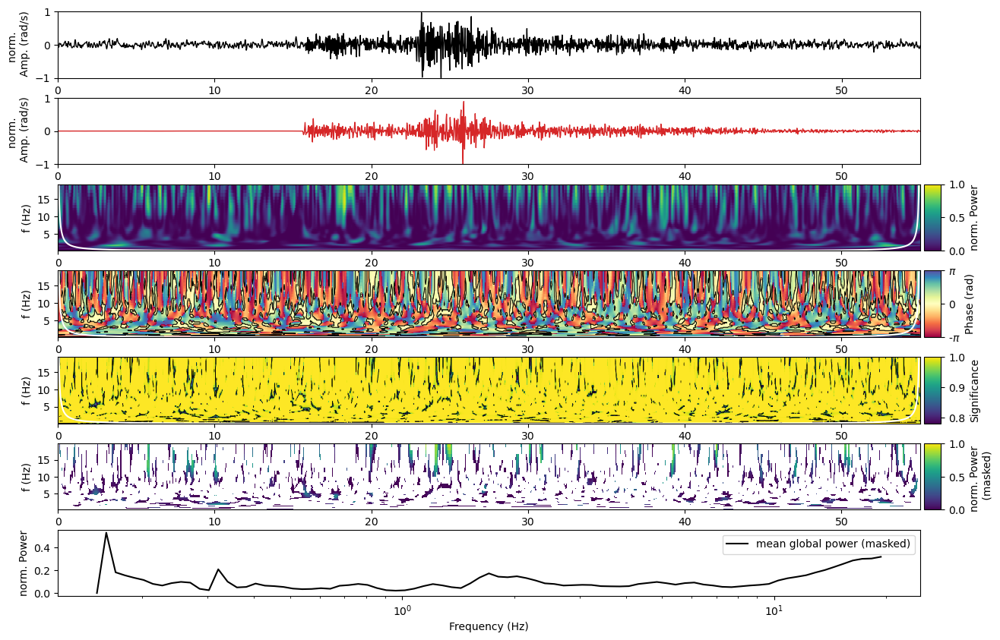


   -> saving /import/kilauea-data/BSPF/figures/wct/20221007_224505_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.02098472385081739 0.010468011794990052


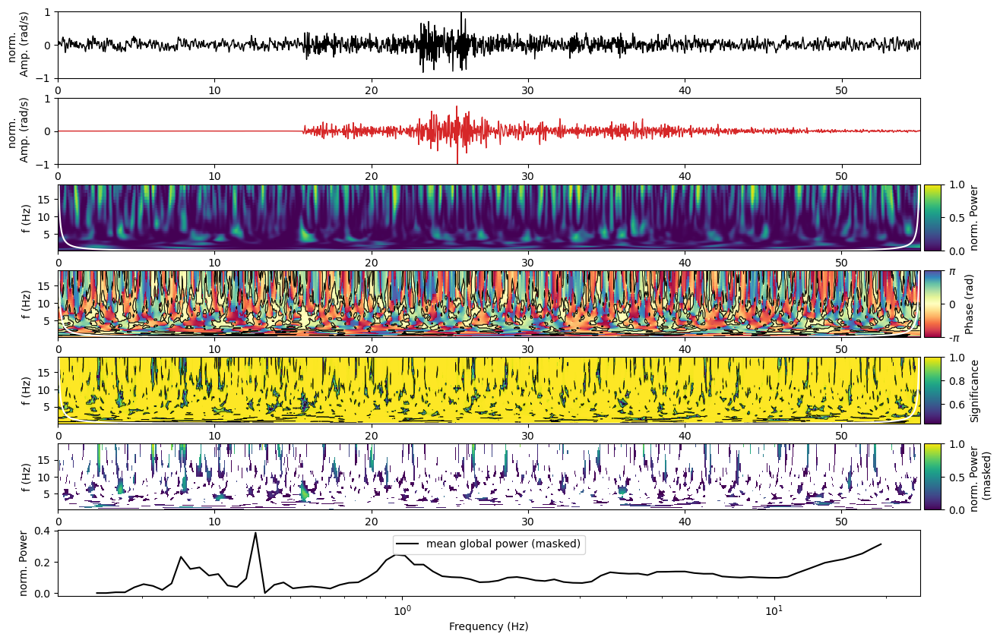


   -> saving /import/kilauea-data/BSPF/figures/wct/20221007_224505_wct_E.png ...

   -> Done



No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


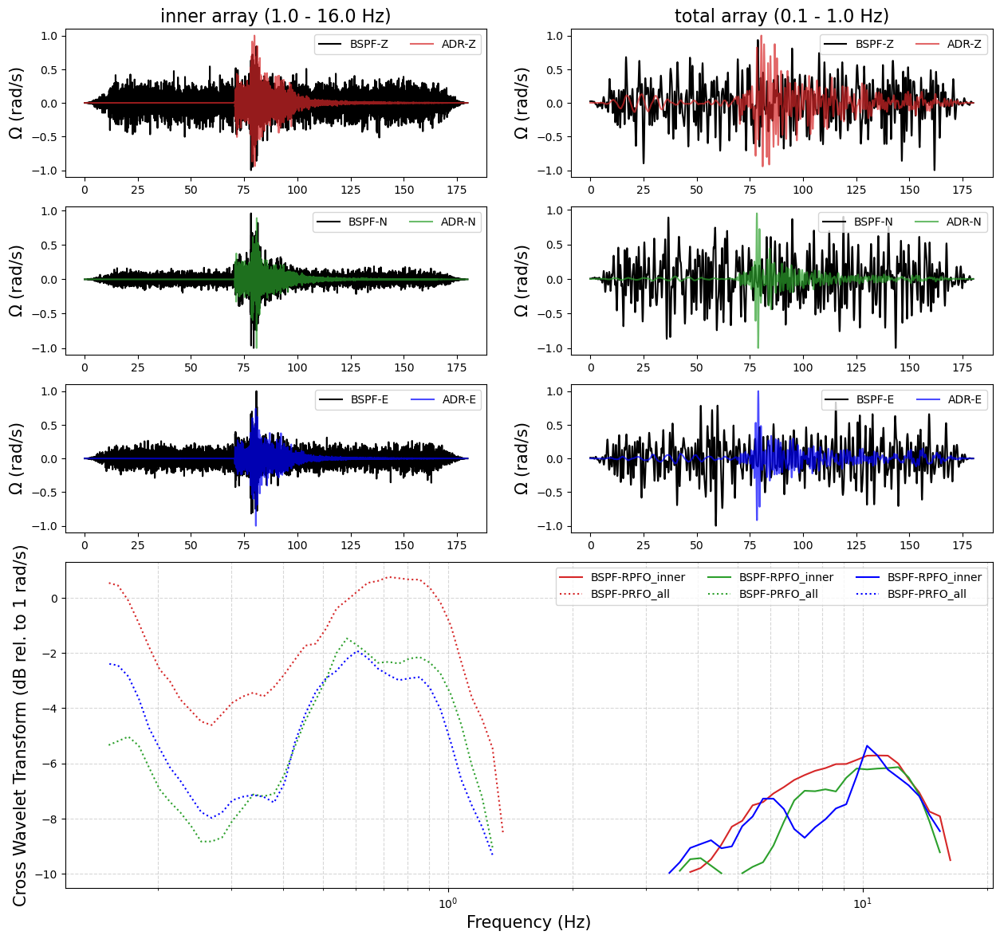


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221007_224505_xwt_comparison.png ...

   -> Done



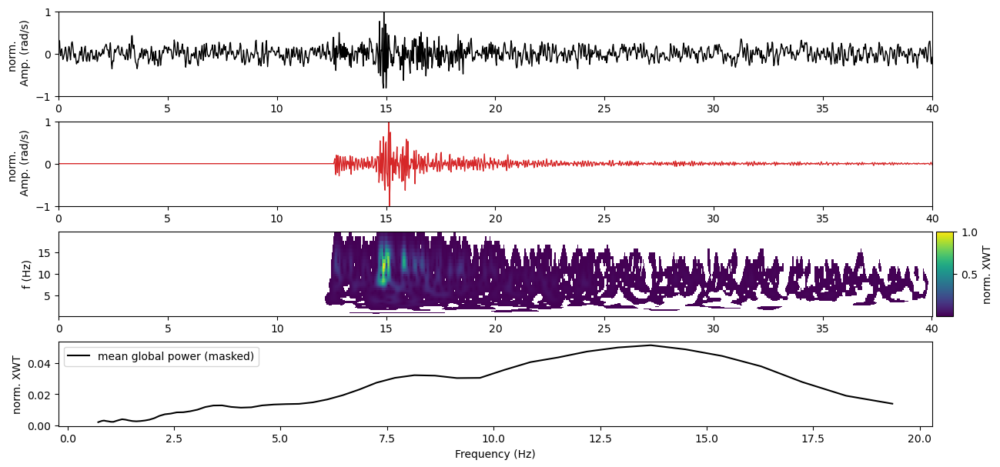


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221015_051734_xwt_Z.png ...

   -> Done



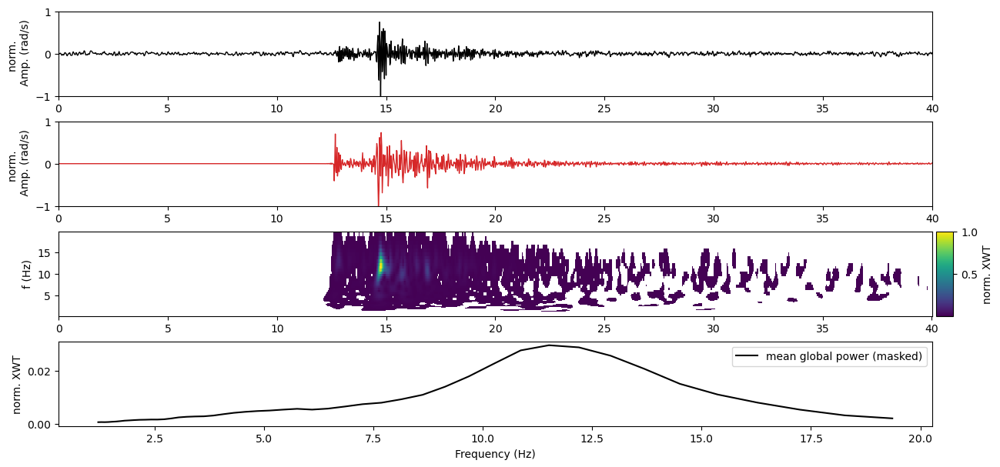


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221015_051734_xwt_N.png ...

   -> Done



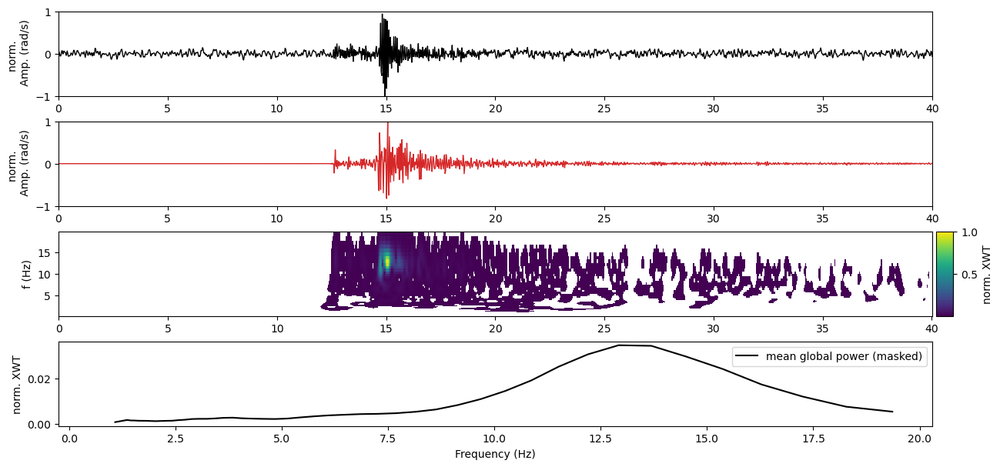


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221015_051734_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.024666265923904293 0.007977938018367532


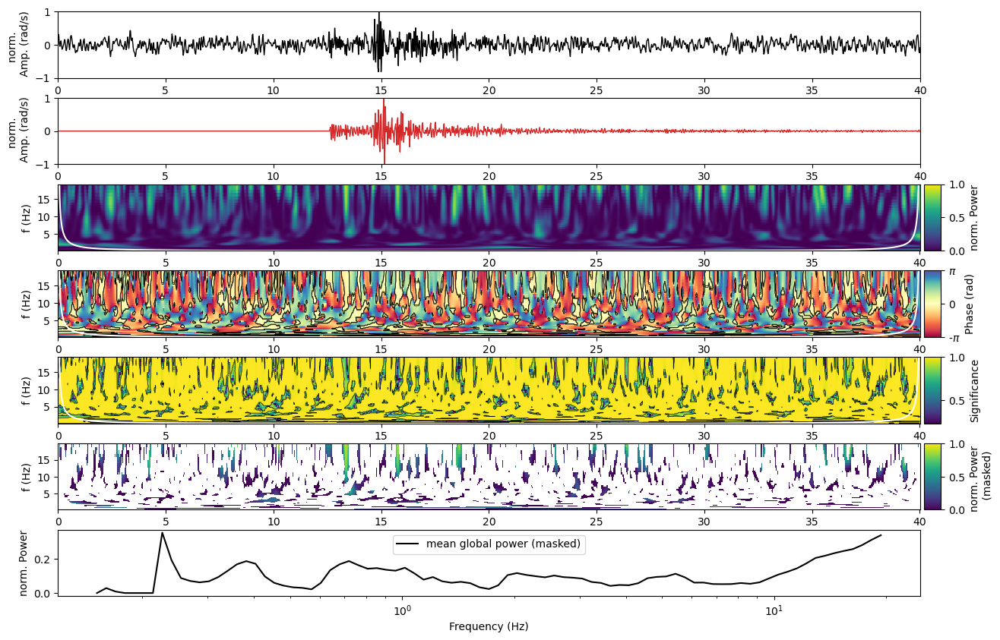


   -> saving /import/kilauea-data/BSPF/figures/wct/20221015_051734_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.004919069173177805 0.007228250723815256


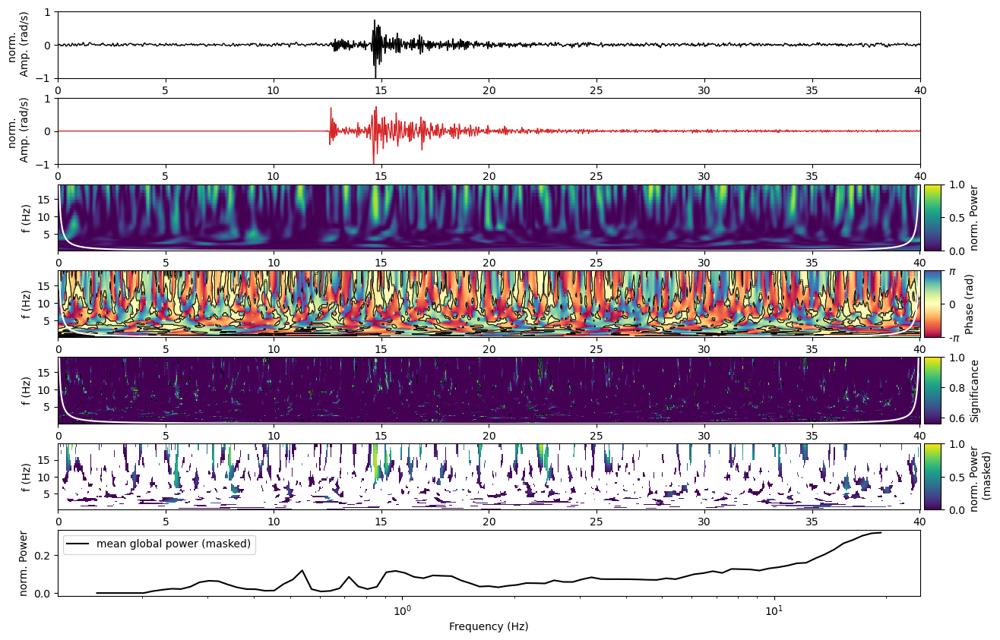


   -> saving /import/kilauea-data/BSPF/figures/wct/20221015_051734_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.008414699808579425 0.007148367495532384


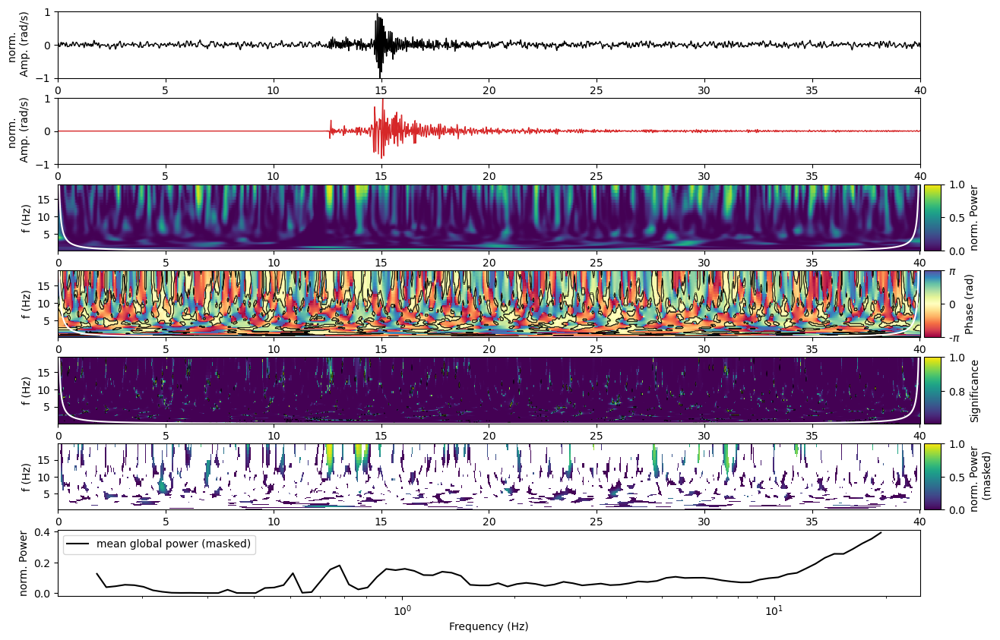


   -> saving /import/kilauea-data/BSPF/figures/wct/20221015_051734_wct_E.png ...

   -> Done



No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


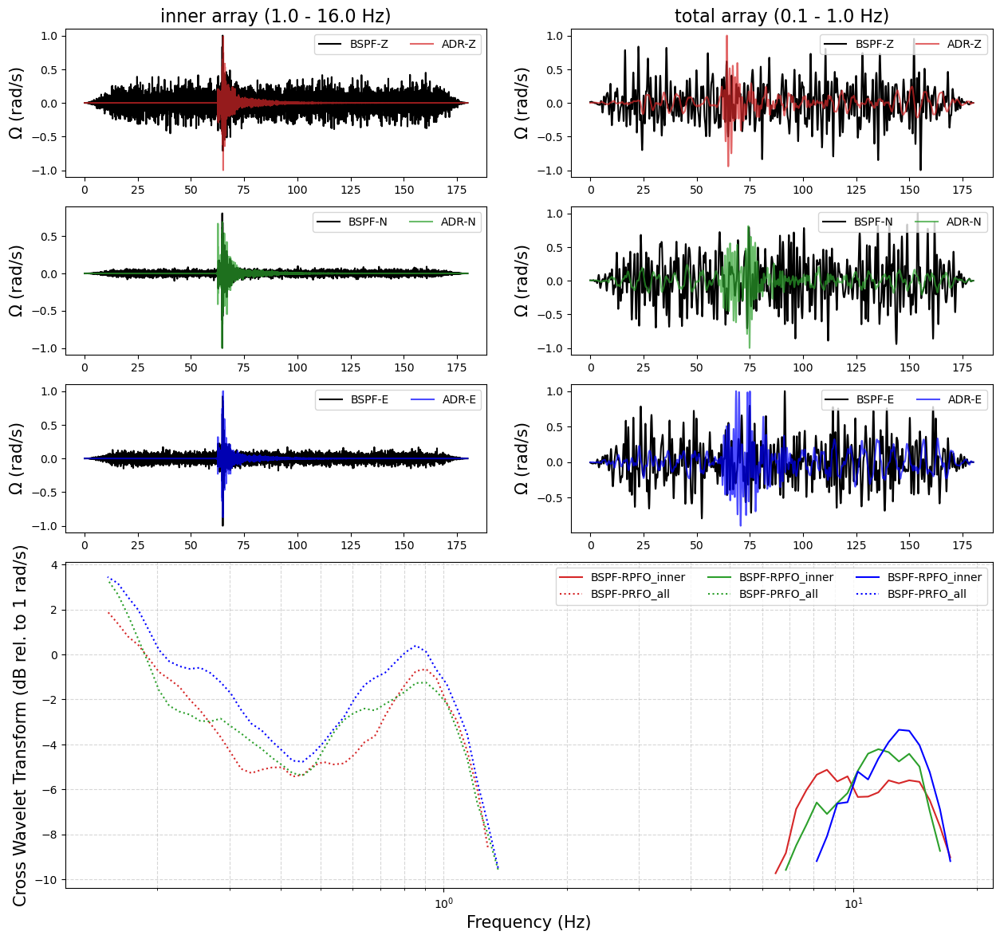


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221015_051734_xwt_comparison.png ...

   -> Done



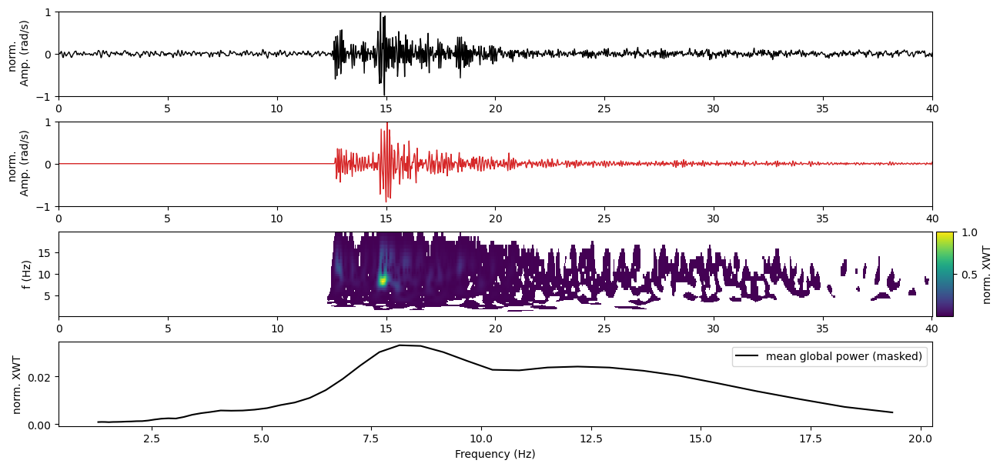


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221023_092458_xwt_Z.png ...

   -> Done



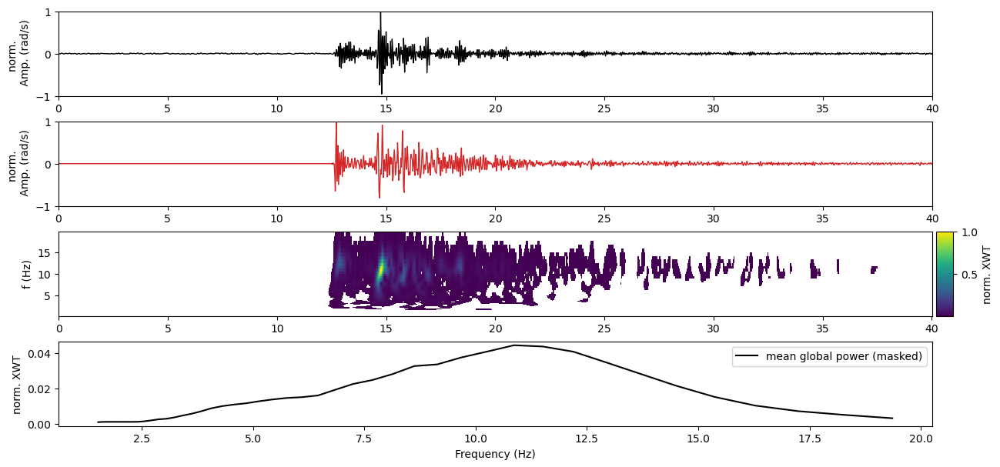


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221023_092458_xwt_N.png ...

   -> Done



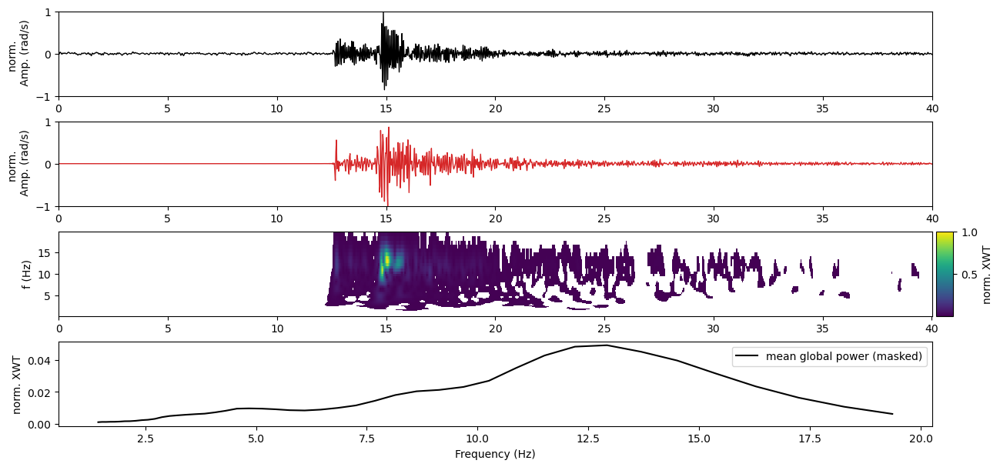


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221023_092458_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.012549742882212658 0.009834478272076907


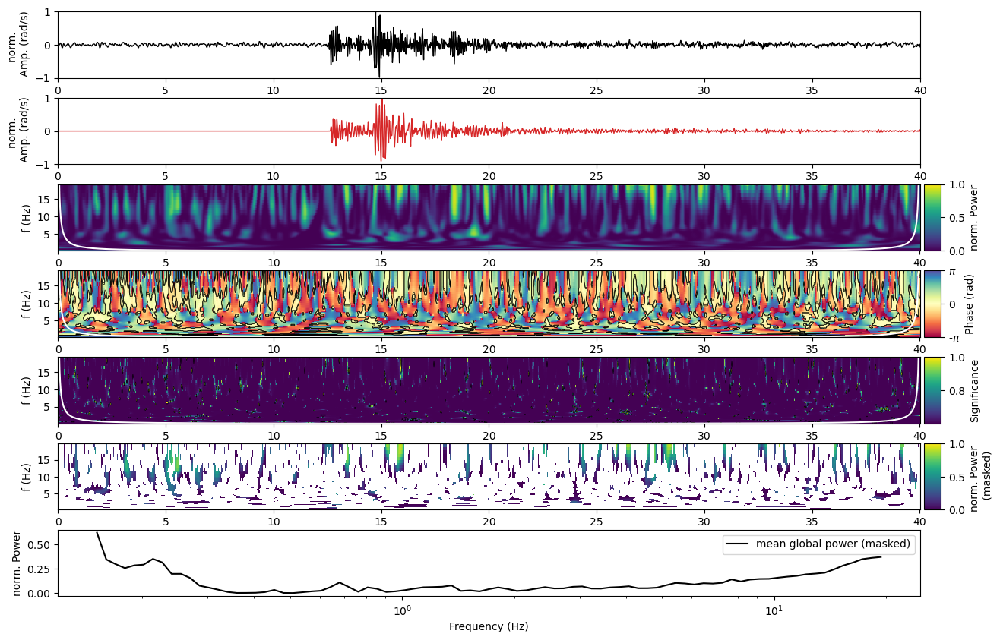


   -> saving /import/kilauea-data/BSPF/figures/wct/20221023_092458_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.006153730788864591 0.009771692466915333


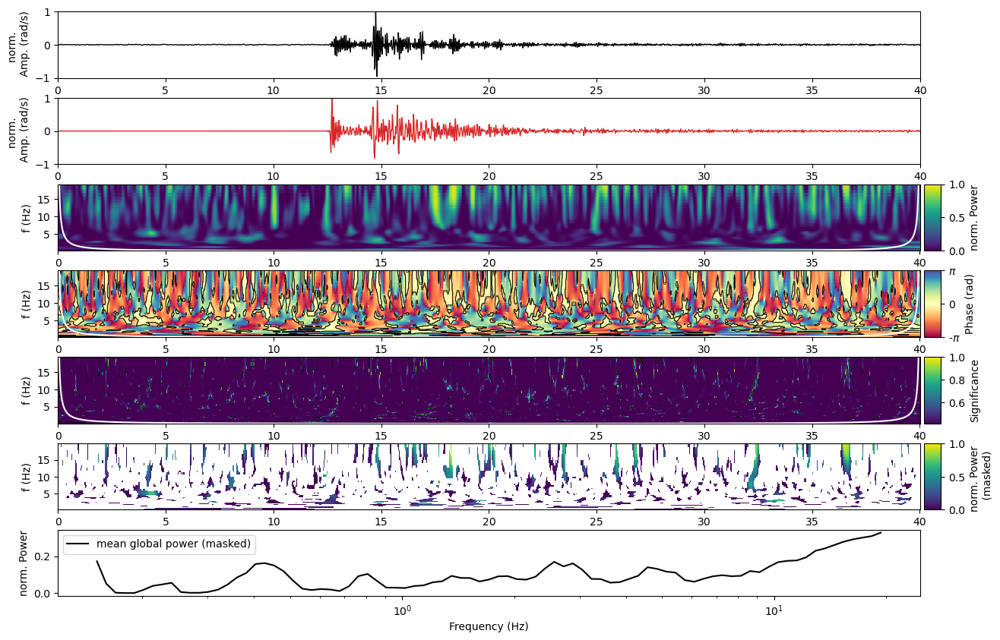


   -> saving /import/kilauea-data/BSPF/figures/wct/20221023_092458_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.00786760155983211 0.010688054706934702


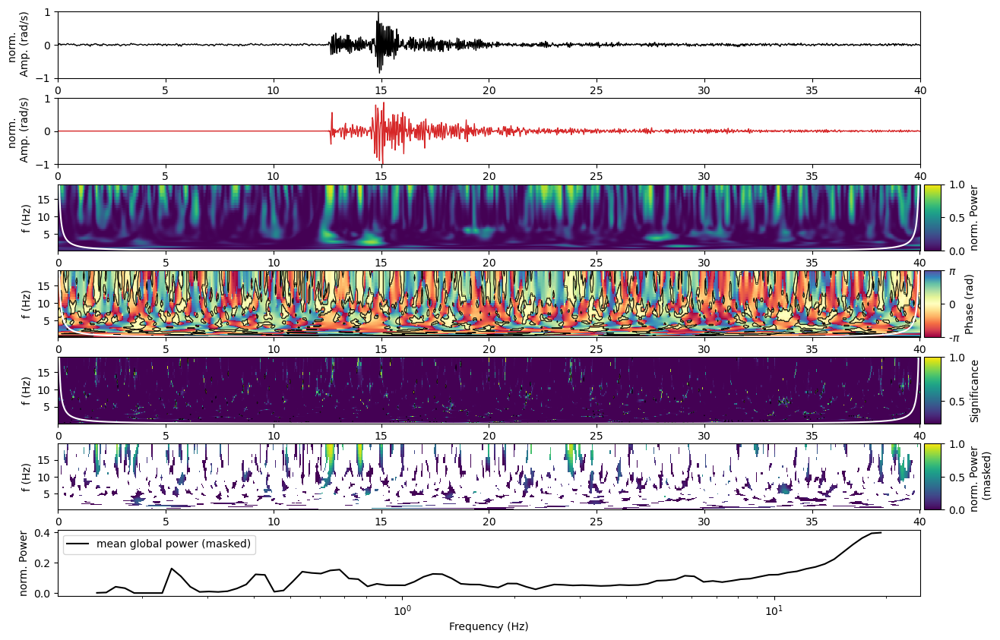


   -> saving /import/kilauea-data/BSPF/figures/wct/20221023_092458_wct_E.png ...

   -> Done



No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


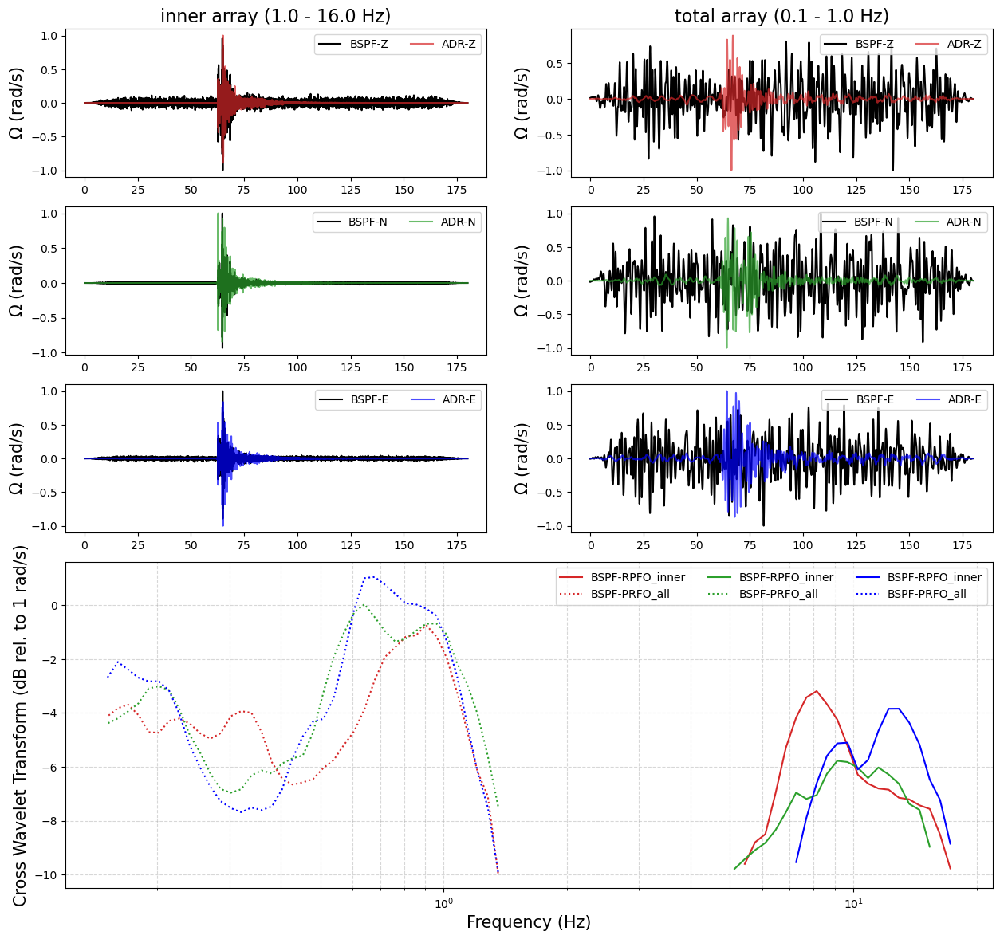


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221023_092458_xwt_comparison.png ...

   -> Done



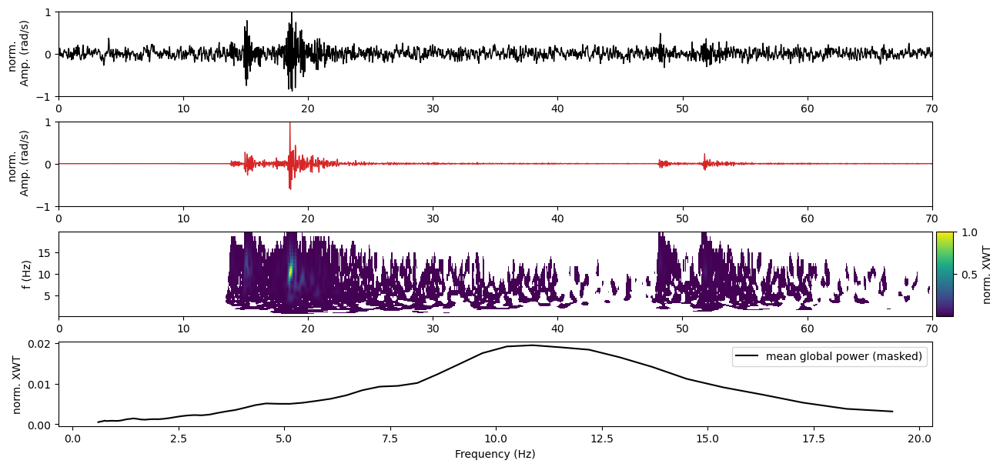


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221026_081435_xwt_Z.png ...

   -> Done



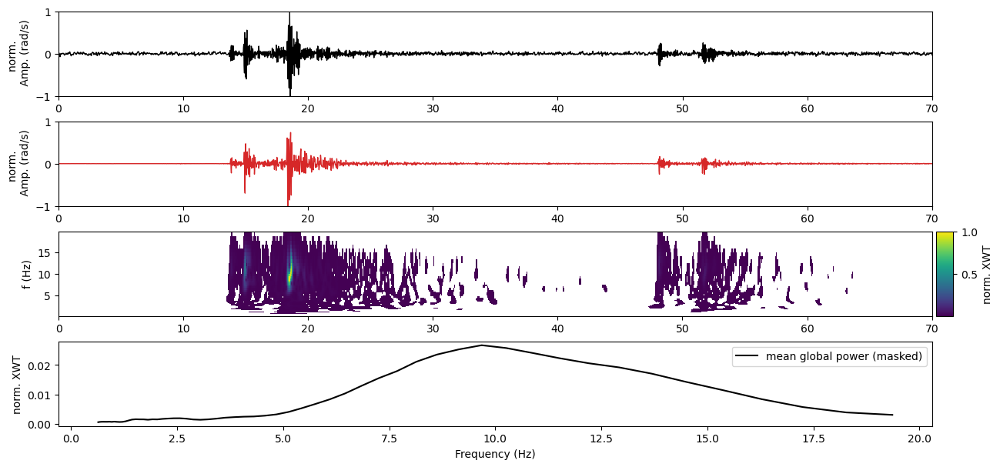


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221026_081435_xwt_N.png ...

   -> Done



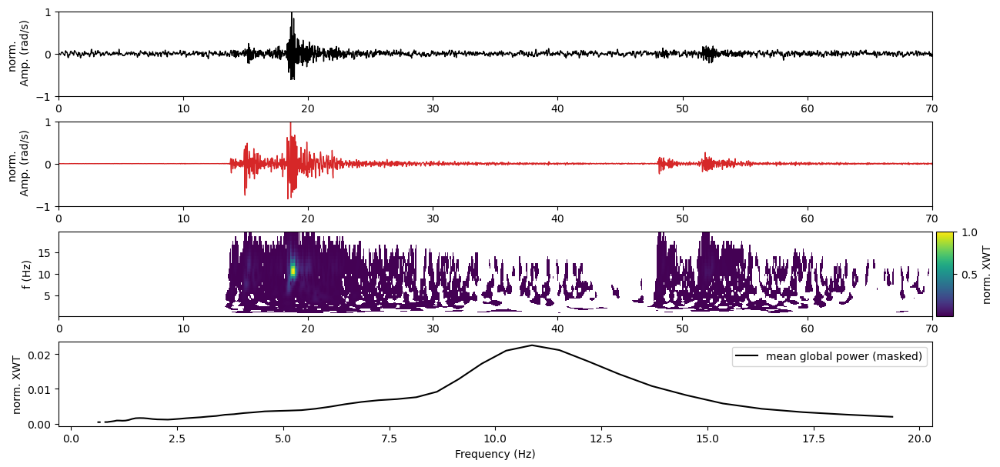


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221026_081435_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.014476533165133528 0.0017881739824377582


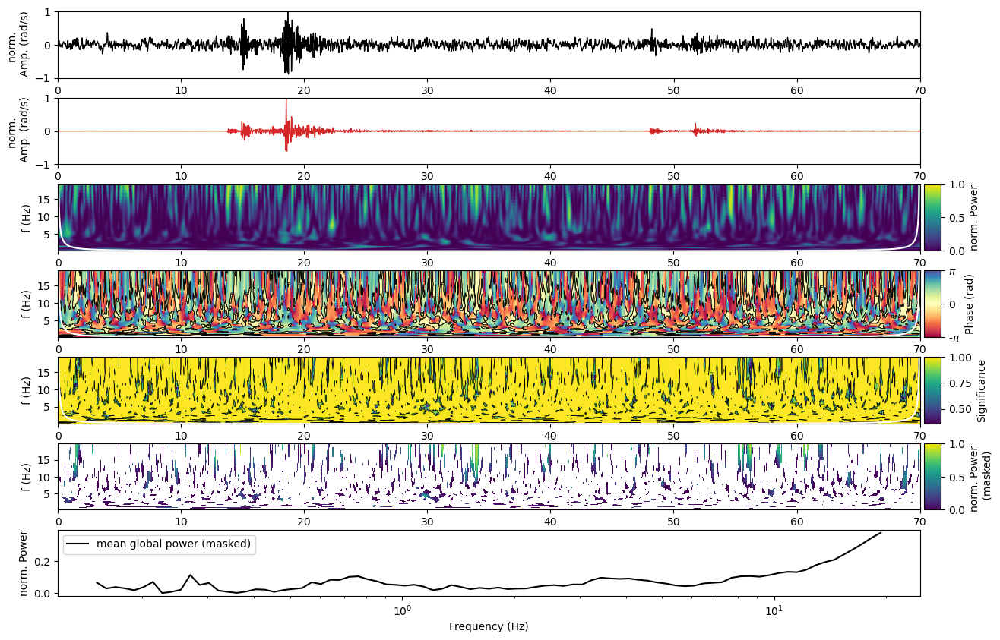


   -> saving /import/kilauea-data/BSPF/figures/wct/20221026_081435_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.005122841984977644 0.0037804826212245323


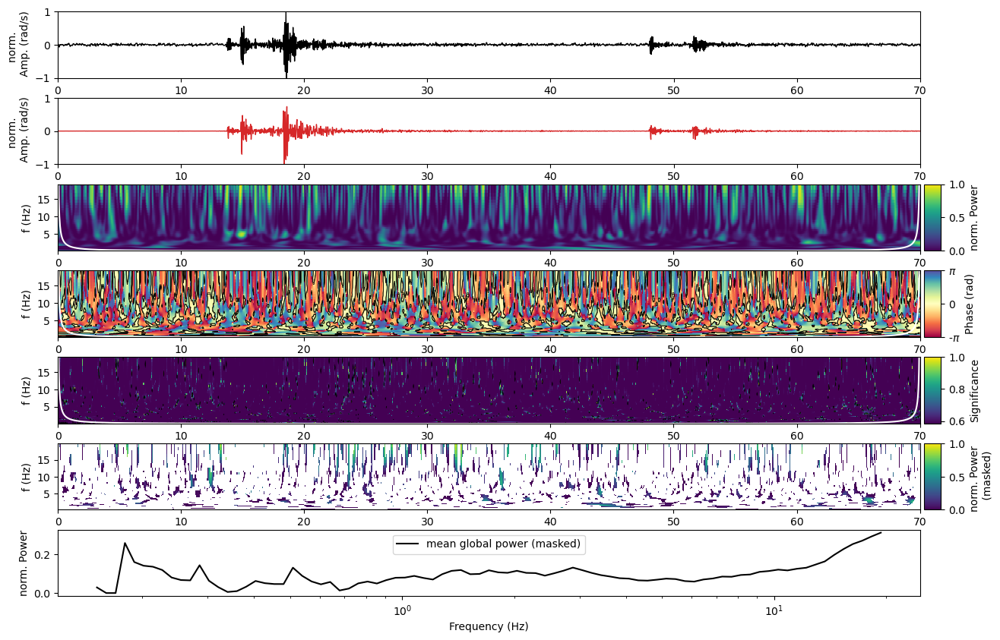


   -> saving /import/kilauea-data/BSPF/figures/wct/20221026_081435_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.004350204407620908 0.006431951112895179


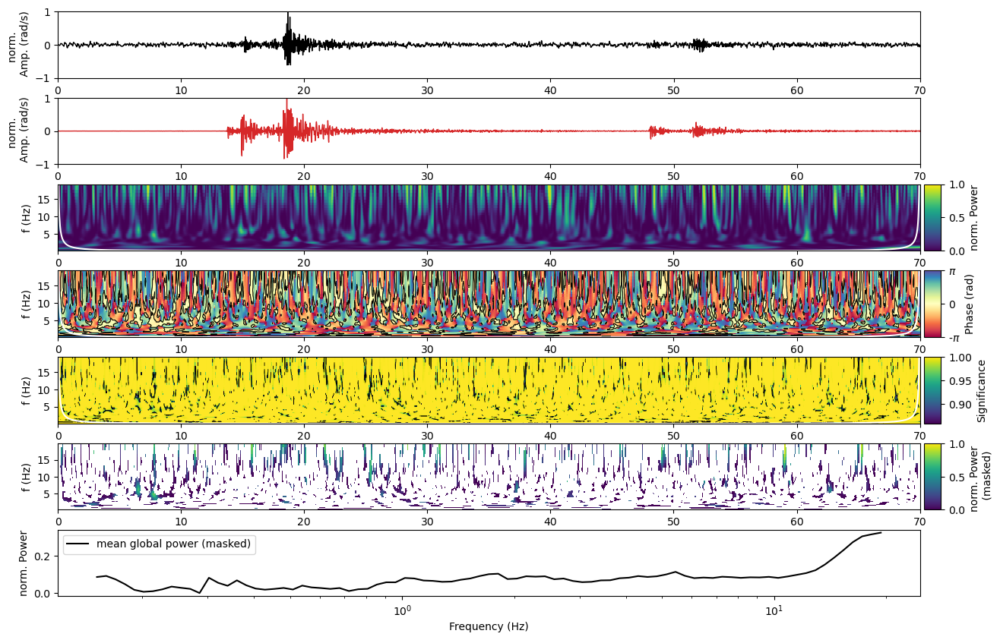


   -> saving /import/kilauea-data/BSPF/figures/wct/20221026_081435_wct_E.png ...

   -> Done



No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


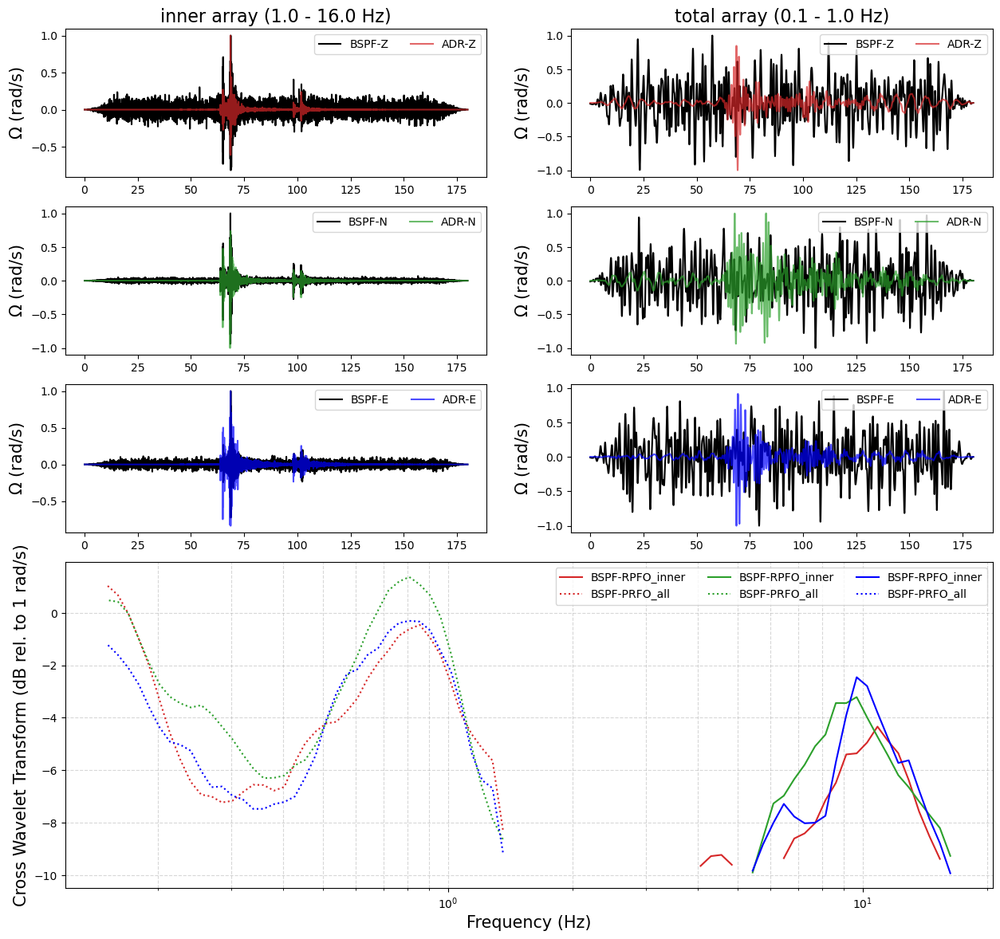


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221026_081435_xwt_comparison.png ...

   -> Done



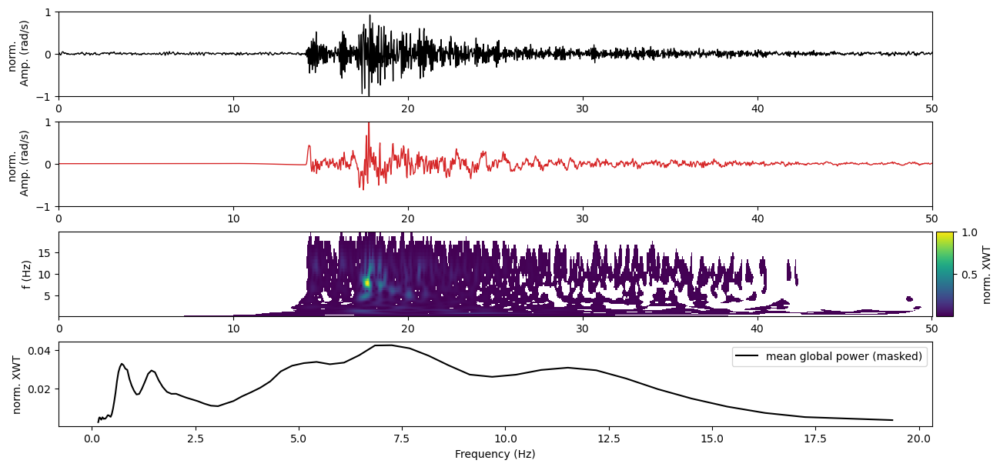


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221231_121226_xwt_Z.png ...

   -> Done



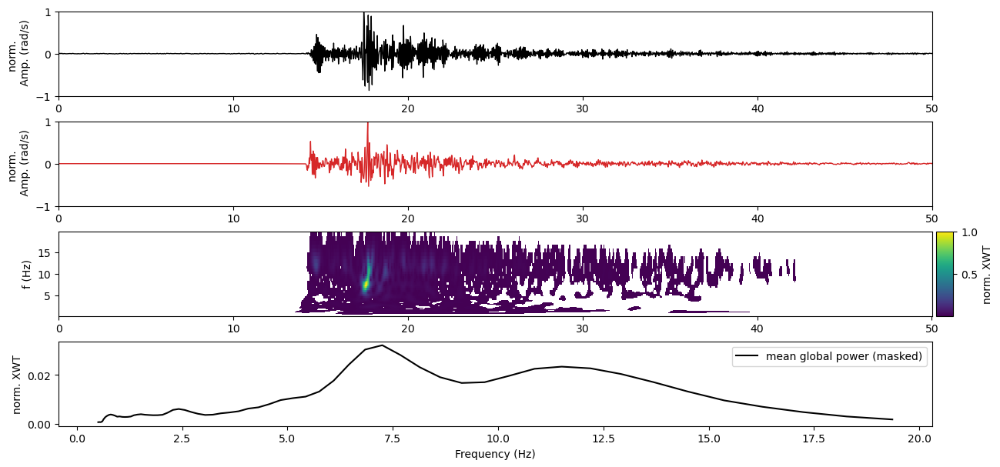


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221231_121226_xwt_N.png ...

   -> Done



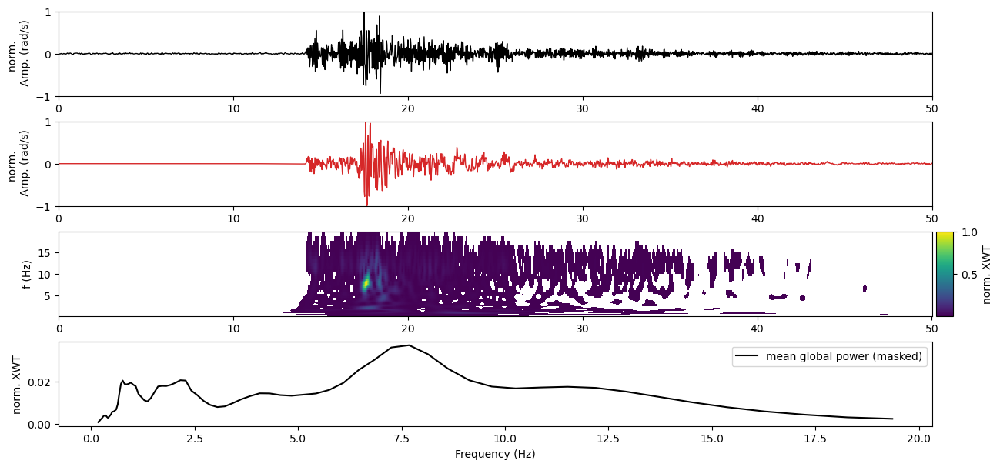


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221231_121226_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.016207146117504553 0.0091897682358798


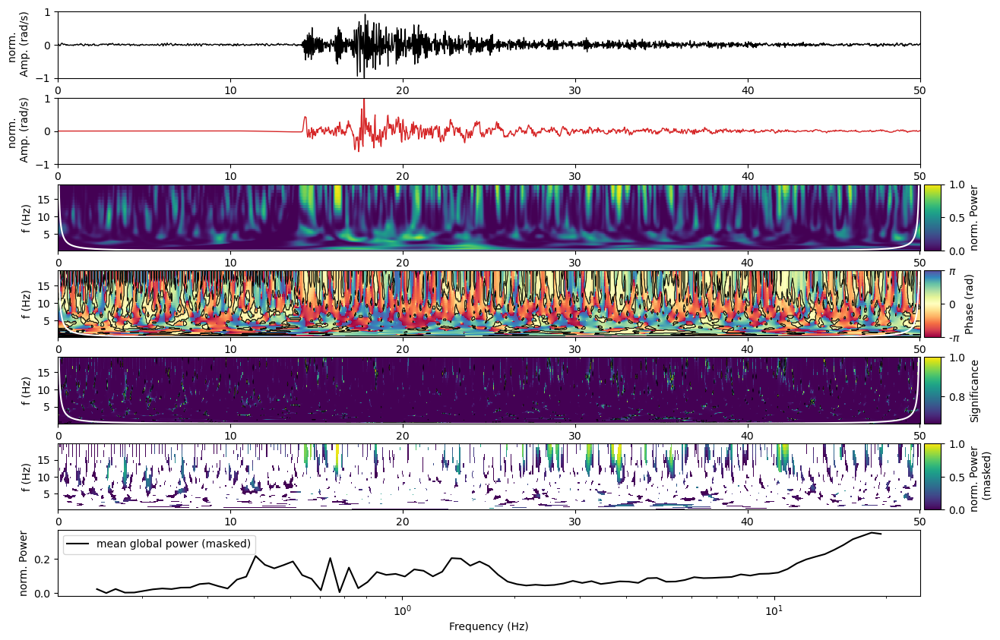


   -> saving /import/kilauea-data/BSPF/figures/wct/20221231_121226_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.010975800048127642 0.005751431551319593


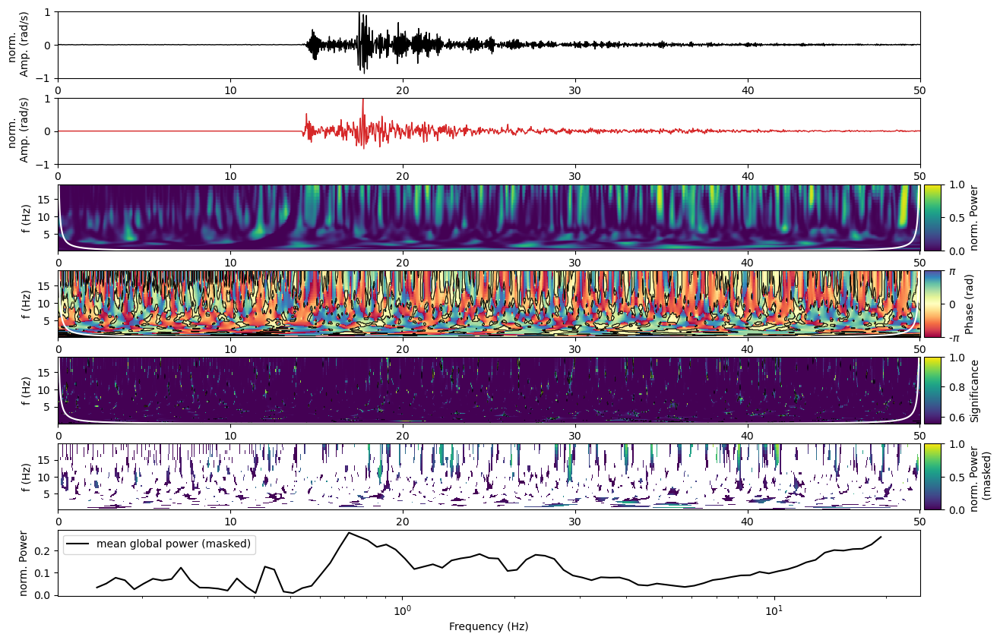


   -> saving /import/kilauea-data/BSPF/figures/wct/20221231_121226_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.011690608143012045 0.011236815752331288


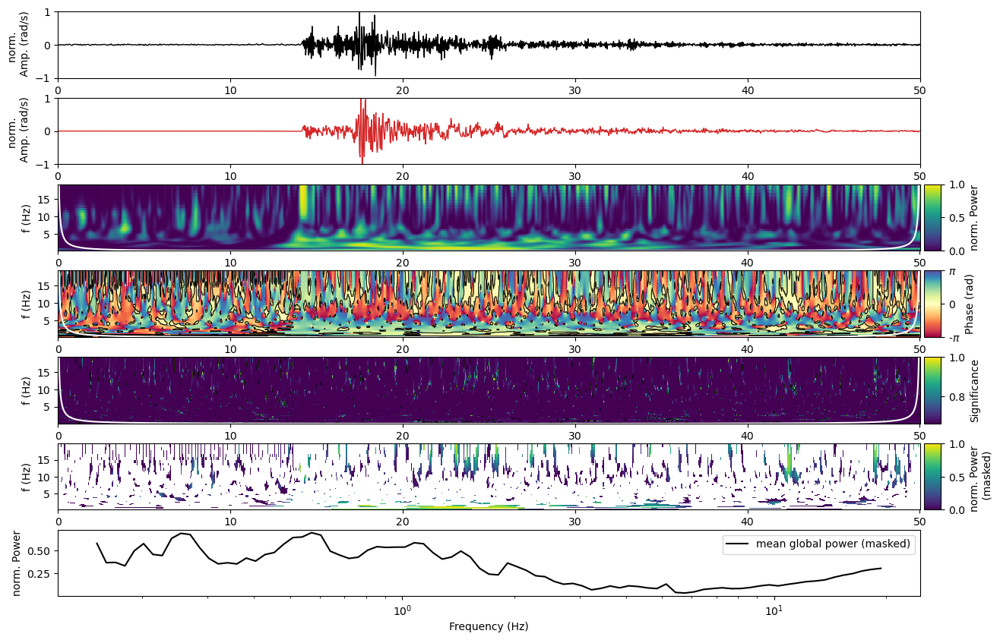


   -> saving /import/kilauea-data/BSPF/figures/wct/20221231_121226_wct_E.png ...

   -> Done



No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


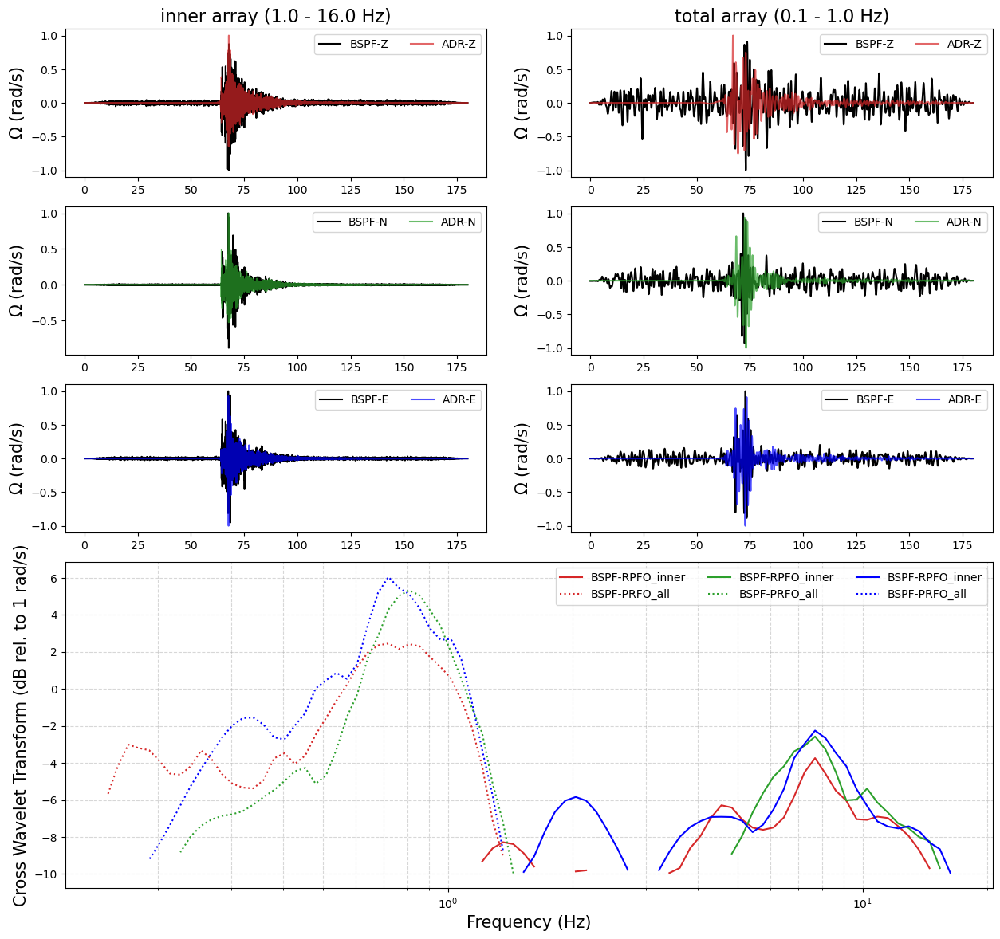


   -> saving /import/kilauea-data/BSPF/figures/xwt/20221231_121226_xwt_comparison.png ...

   -> Done



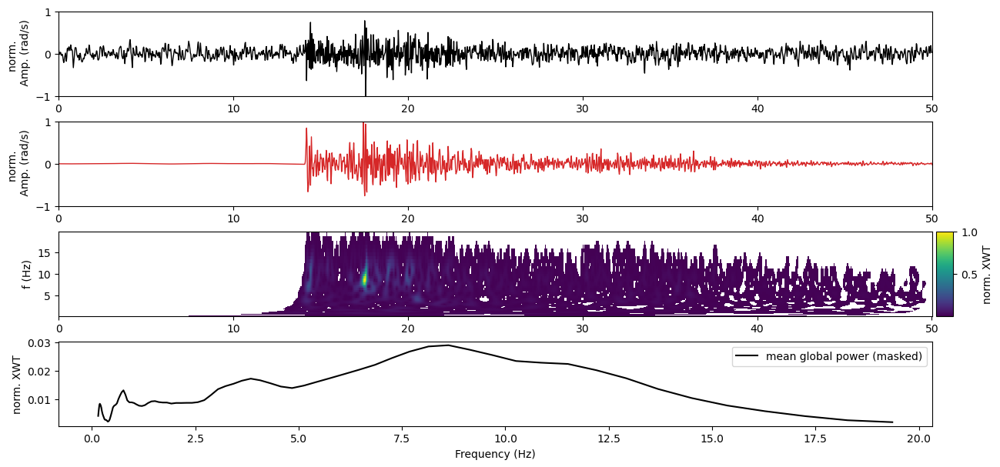


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230109_194256_xwt_Z.png ...

   -> Done



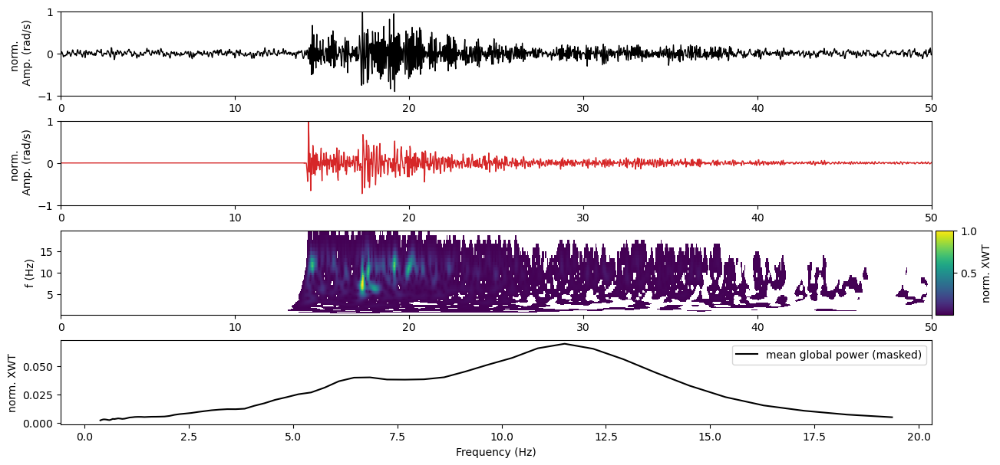


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230109_194256_xwt_N.png ...

   -> Done



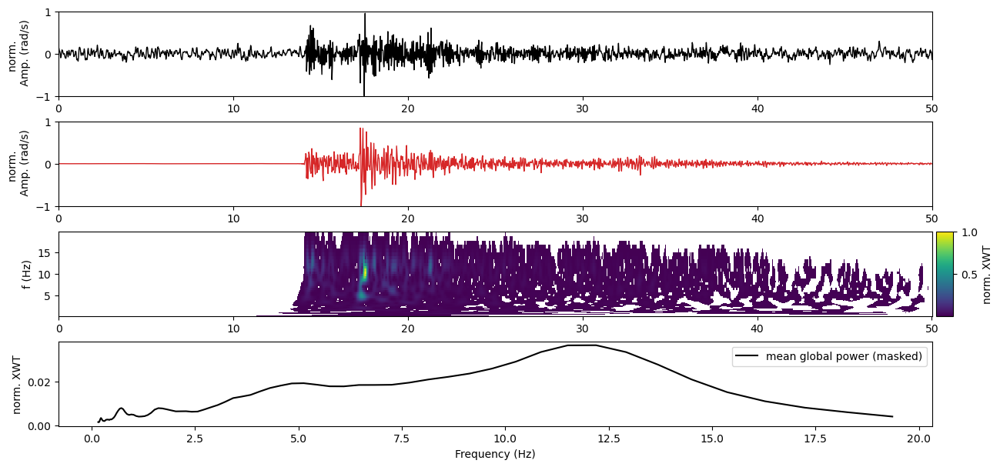


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230109_194256_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.02039968747867026 0.01592439776588954


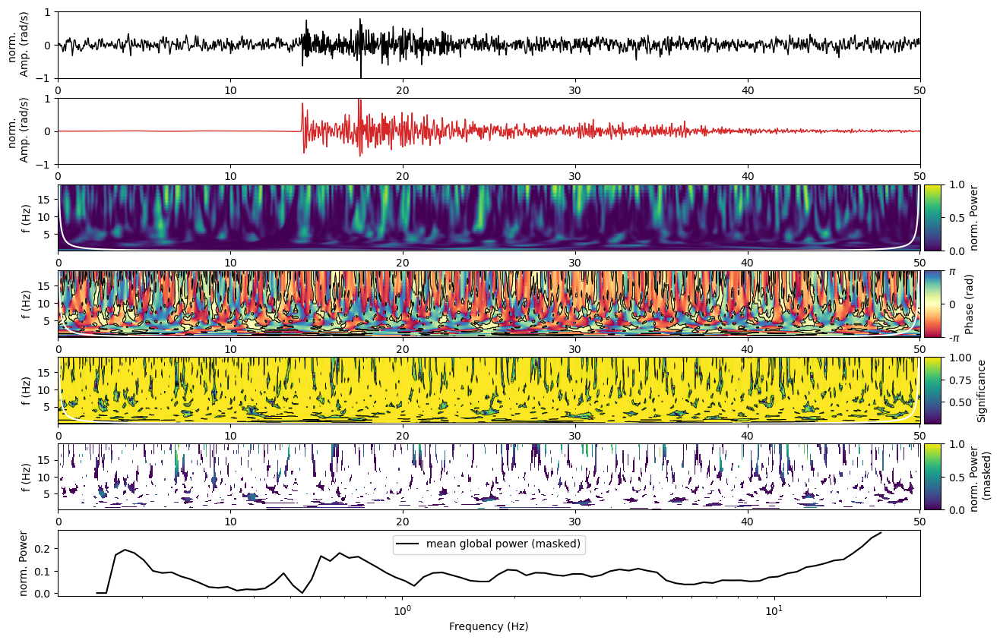


   -> saving /import/kilauea-data/BSPF/figures/wct/20230109_194256_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.019564383072875512 0.008928406971289316


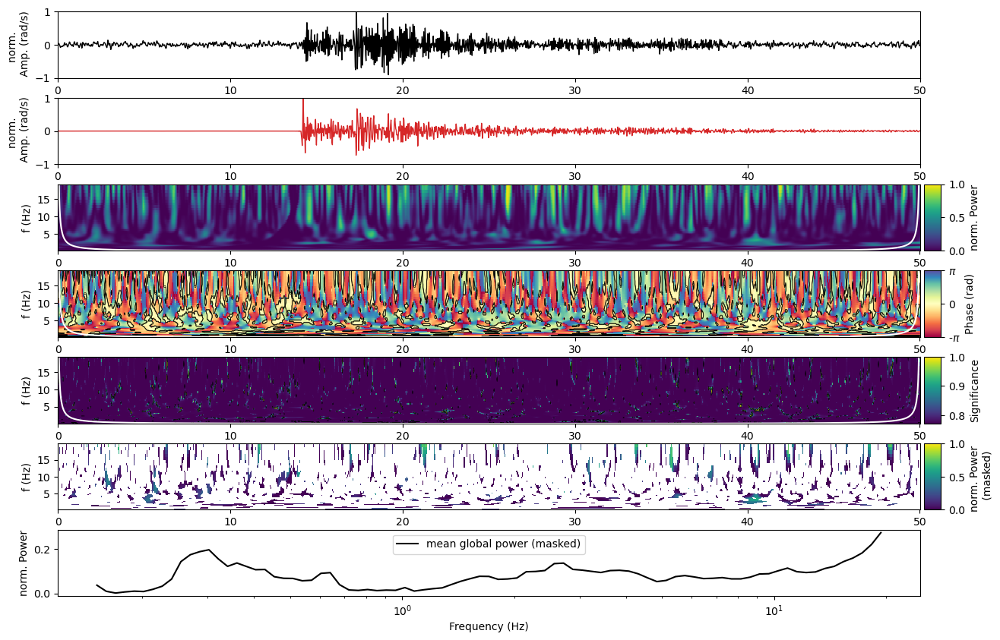


   -> saving /import/kilauea-data/BSPF/figures/wct/20230109_194256_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.015434782285932303 0.009096904724461721


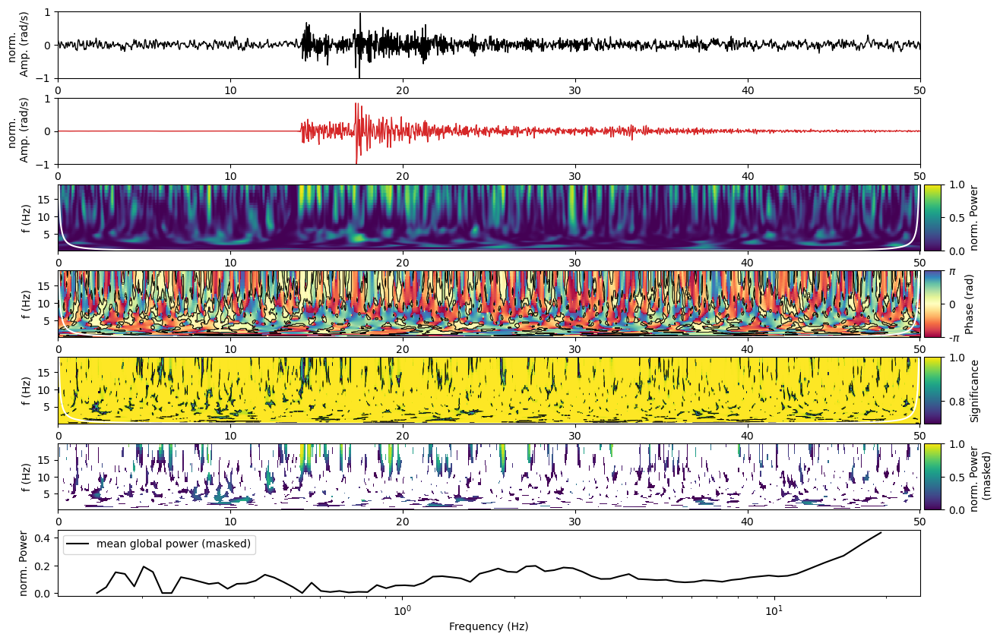


   -> saving /import/kilauea-data/BSPF/figures/wct/20230109_194256_wct_E.png ...

   -> Done



No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


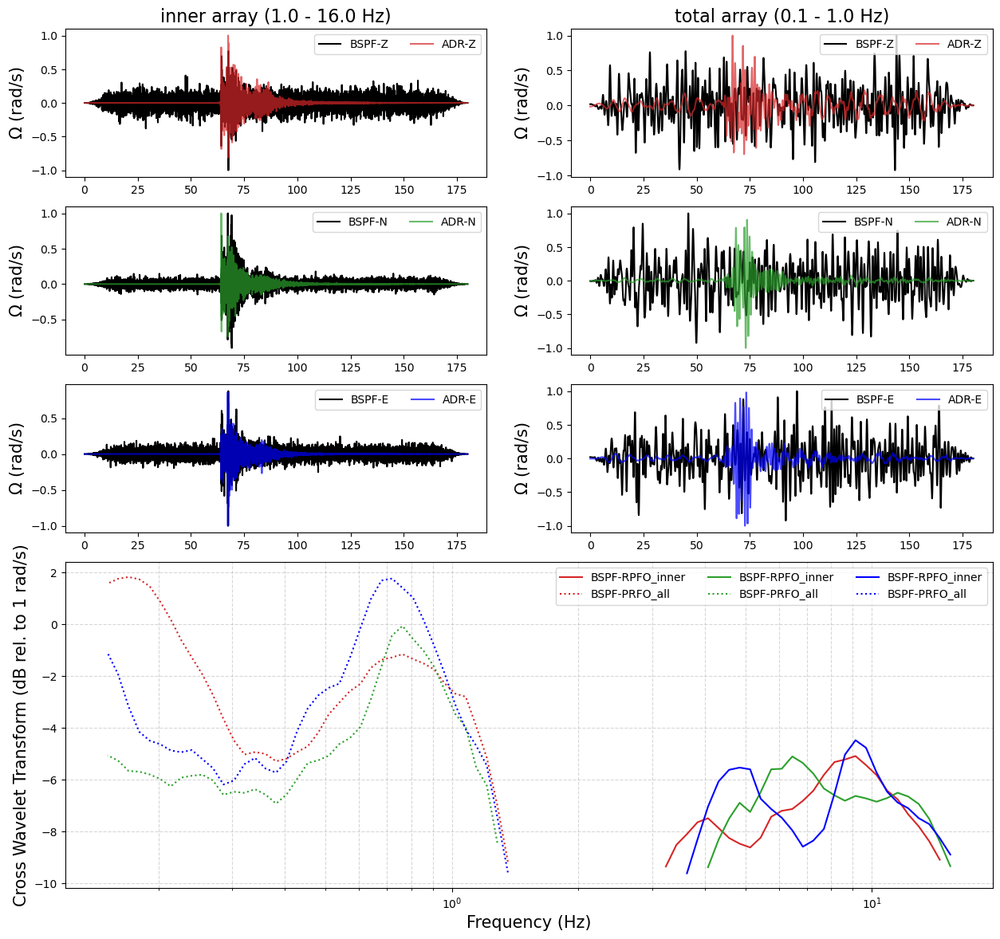


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230109_194256_xwt_comparison.png ...

   -> Done



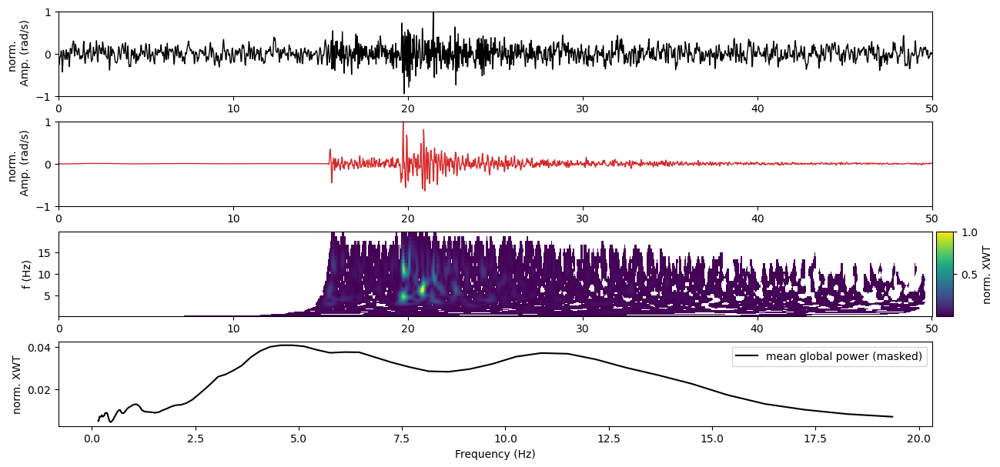


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230111_185920_xwt_Z.png ...

   -> Done



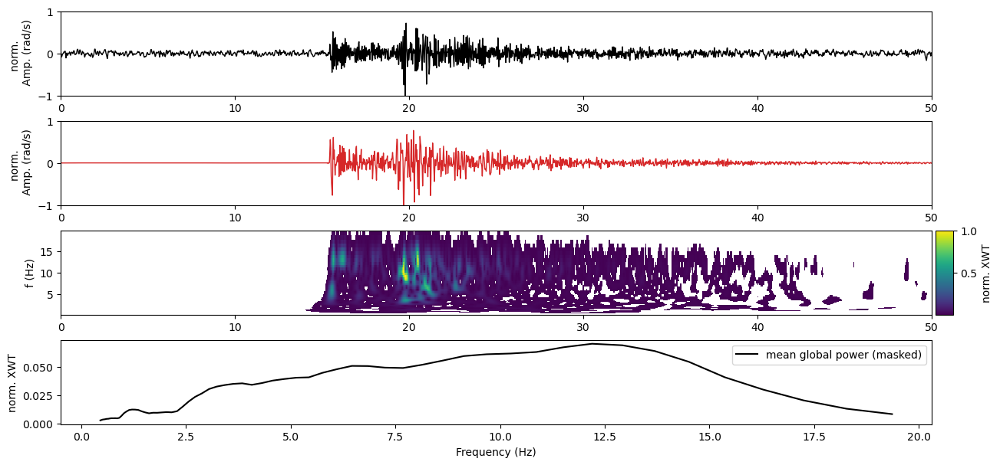


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230111_185920_xwt_N.png ...

   -> Done



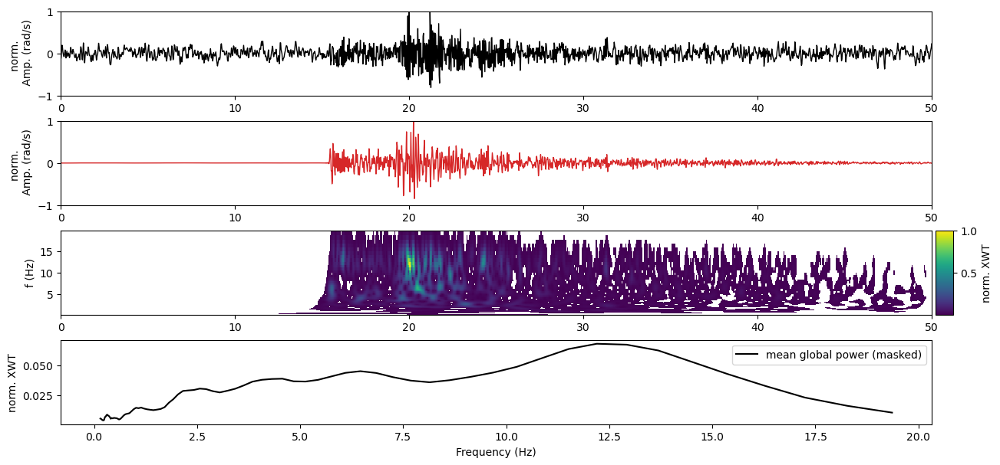


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230111_185920_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.027250503194723392 0.0067851310078046265


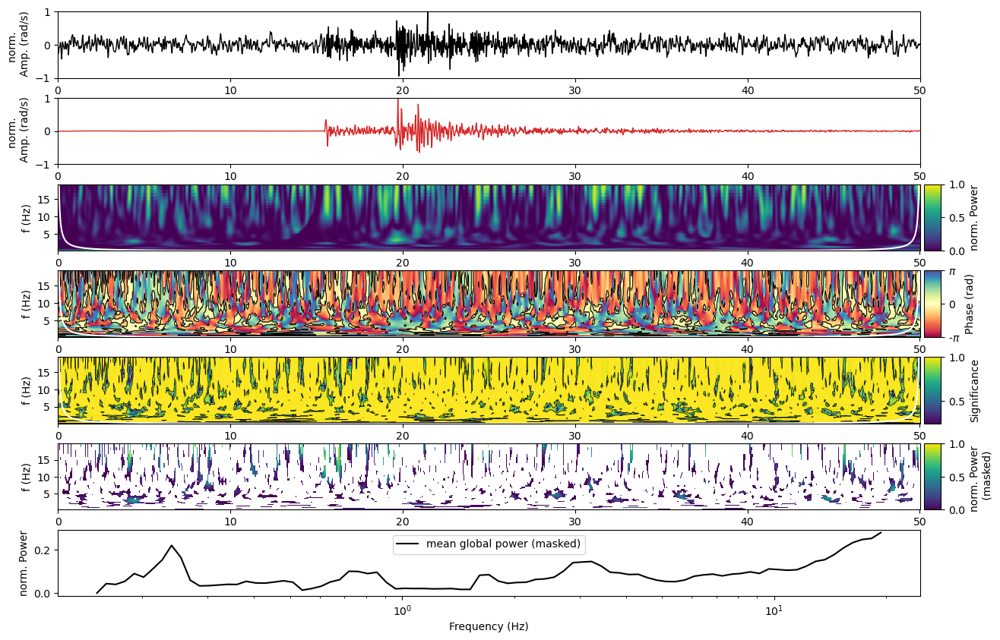


   -> saving /import/kilauea-data/BSPF/figures/wct/20230111_185920_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.010669935738600183 0.012332594981046843


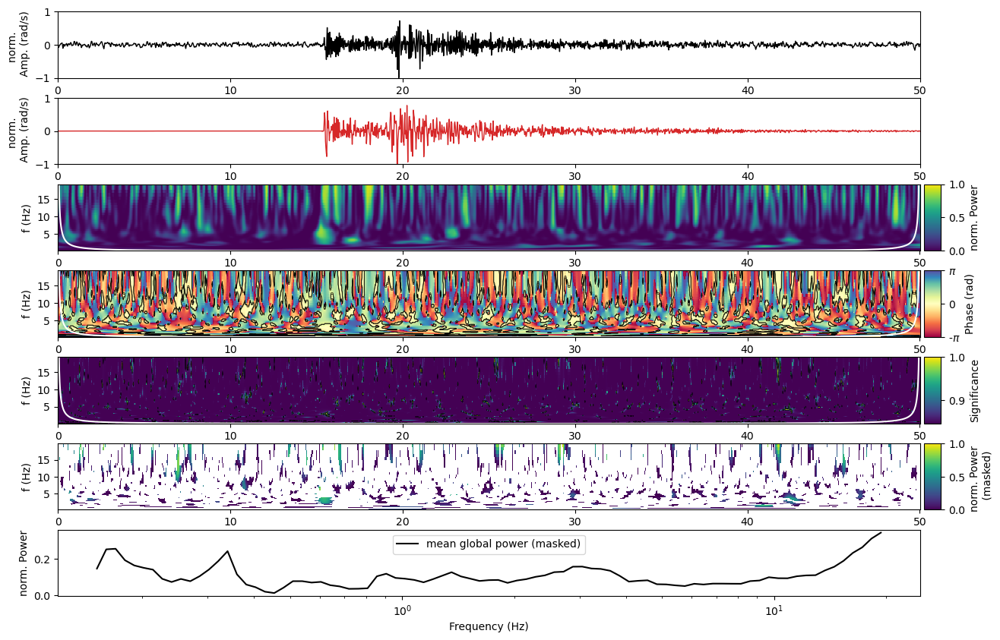


   -> saving /import/kilauea-data/BSPF/figures/wct/20230111_185920_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.02315222070959371 0.010994574467850274


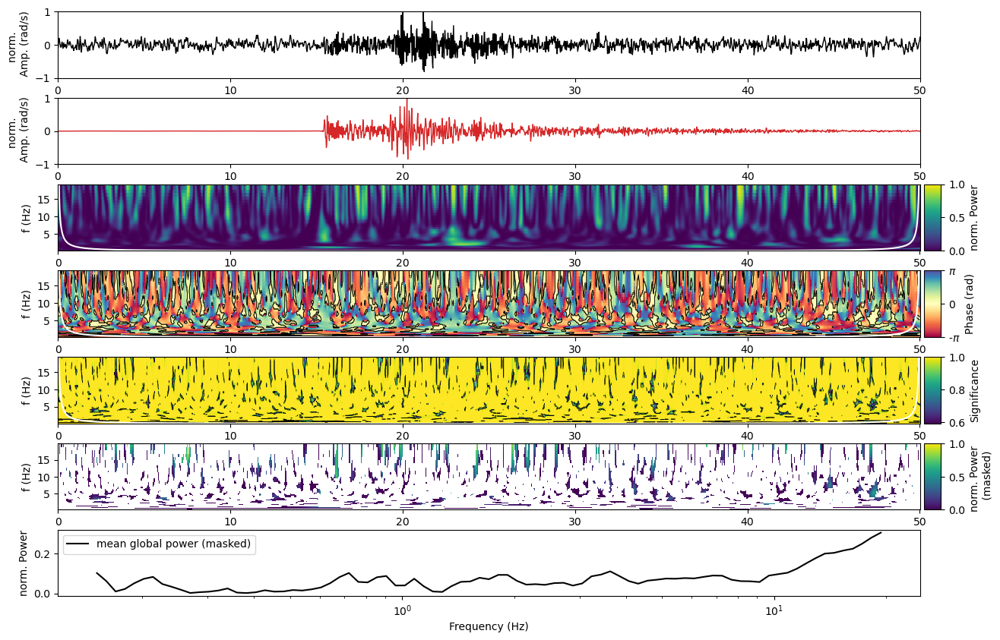


   -> saving /import/kilauea-data/BSPF/figures/wct/20230111_185920_wct_E.png ...

   -> Done



No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


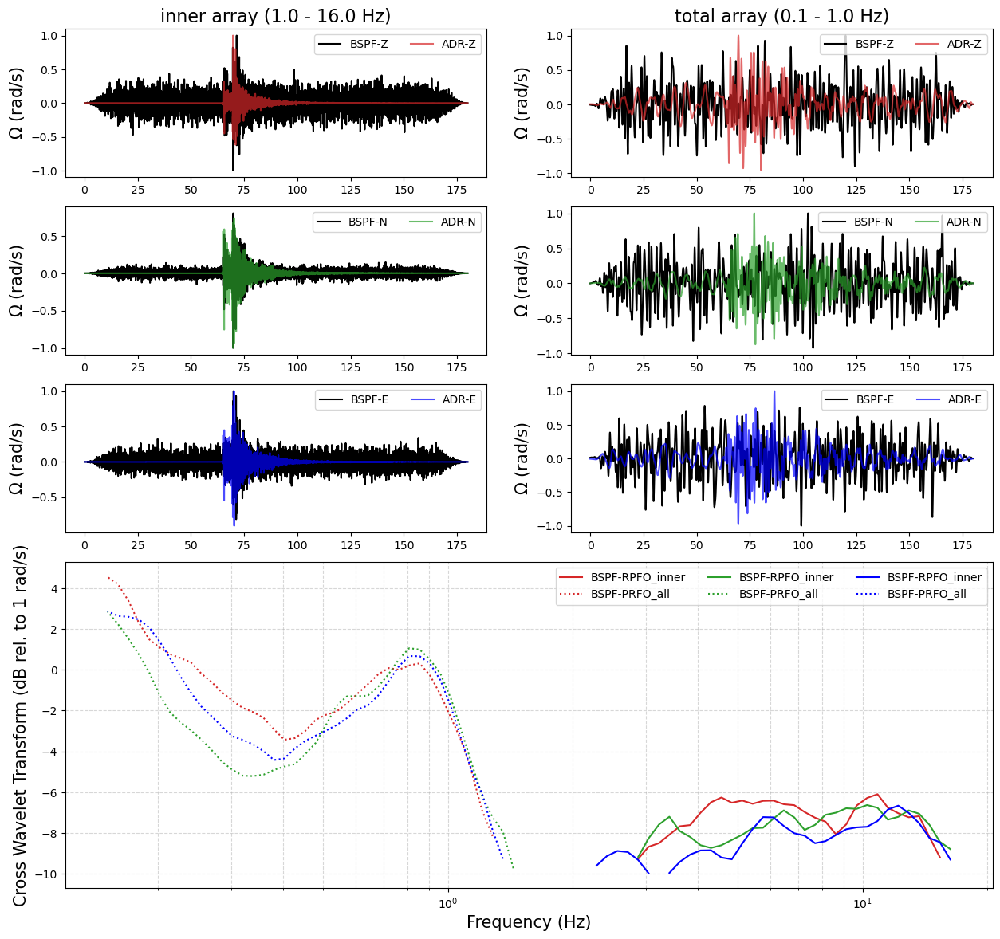


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230111_185920_xwt_comparison.png ...

   -> Done



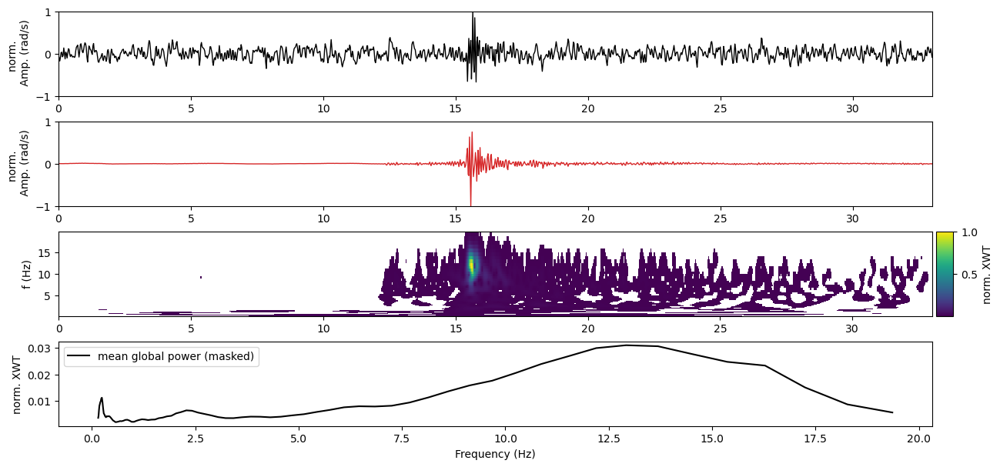


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230115_095854_xwt_Z.png ...

   -> Done



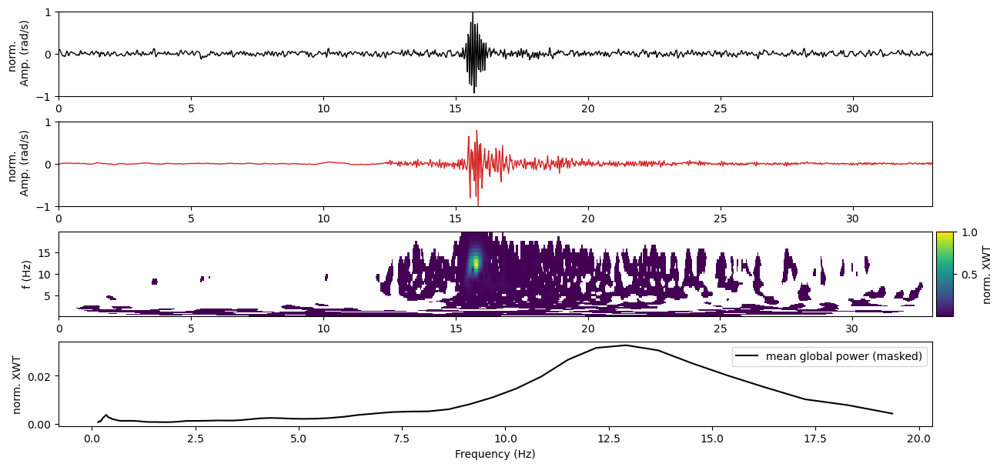


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230115_095854_xwt_N.png ...

   -> Done



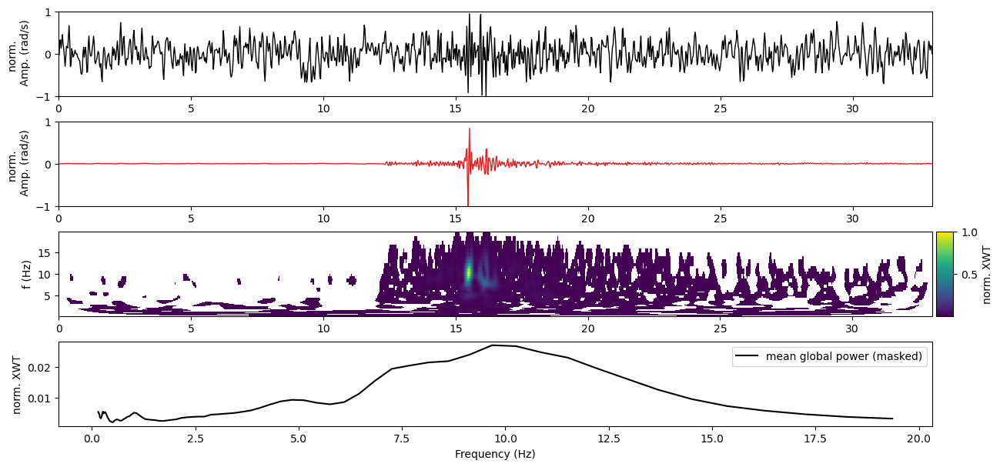


   -> saving /import/kilauea-data/BSPF/figures/xwt/20230115_095854_xwt_E.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.018038445873897226 0.0029002409547812503


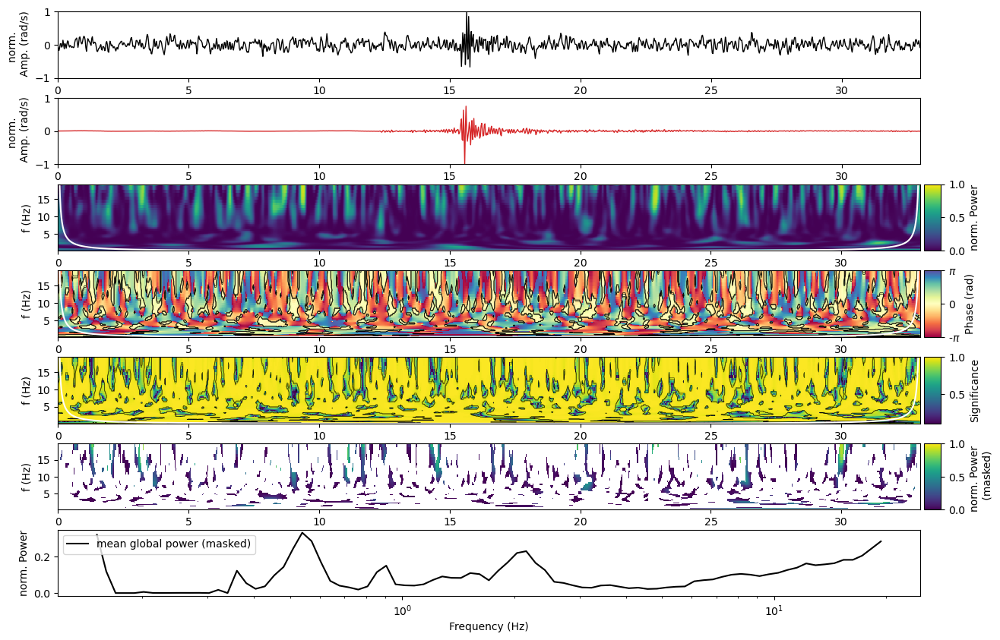


   -> saving /import/kilauea-data/BSPF/figures/wct/20230115_095854_wct_Z.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.007363831693891393 0.00649163065852081


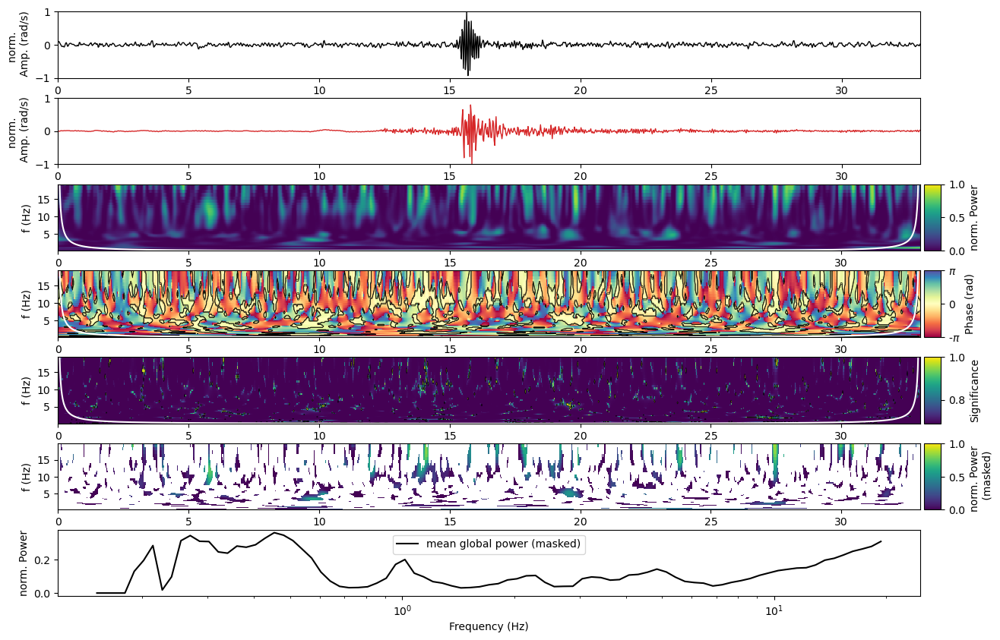


   -> saving /import/kilauea-data/BSPF/figures/wct/20230115_095854_wct_N.png ...

   -> Done

NOTE: WCT significance loaded from cache.

0.07279748066398617 0.002681564548210121


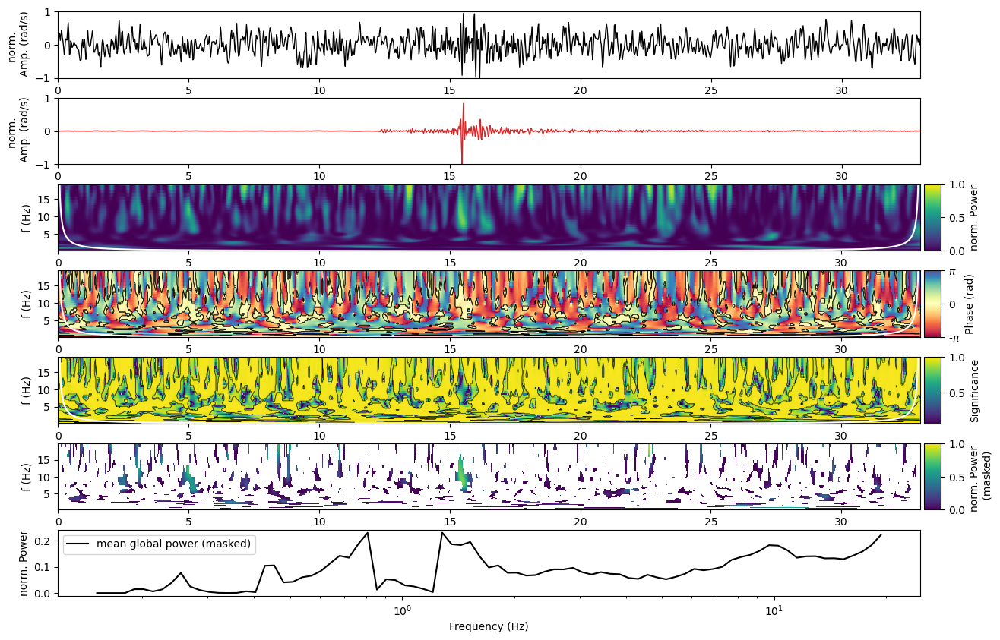


   -> saving /import/kilauea-data/BSPF/figures/wct/20230115_095854_wct_E.png ...

   -> Done



Warning: Cannot place an upperbound on the unbiased AR(1). Series is too short or trend is to large.

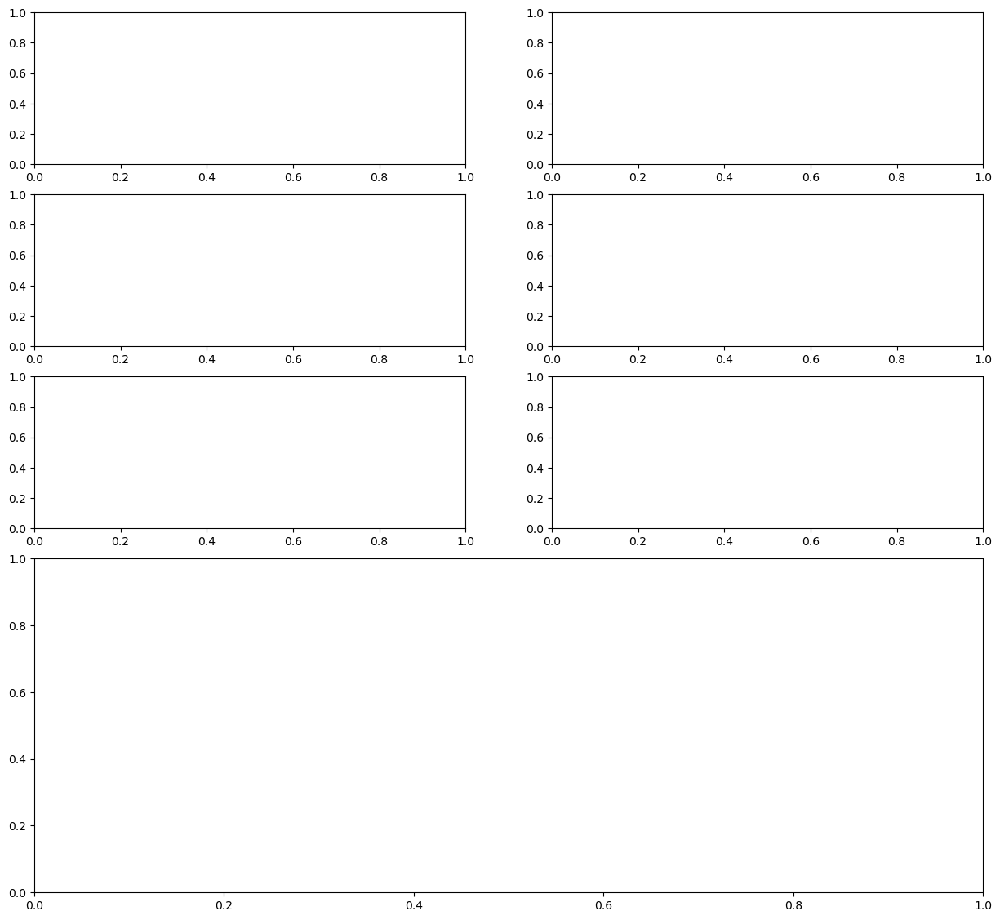

In [323]:

config['eventtime'] = event_time

config['adr_name'] = "inner"  ## inner | all

config['fmin'], config['fmax'] = 0.1, 18


for i in range(0, 17):

    event_time = event_times.origin_time.loc[i]

    try:
        event = events.filter(f"time >= {event_time}",f"time <= {event_time}")
        trig = triggered[triggered.origin == event_time]
    except:
        print(f" -> {i} no event in catalog")


    ## prepare string
    event_time_str = event_time.split(".")[0].replace(" ","_").replace("-","").replace(":","")

    st = obs.read(config['path_to_mseed']+f"*{event_time_str}*");
    st = st.resample(40).trim(st[0].stats.starttime, st[0].stats.endtime);

    st1 = st.copy()

    st = st.detrend("simple");
    st = st.taper(0.01);
    st = st.filter("bandpass", freqmin=config['fmin'], freqmax=config['fmax'], corners=4, zerophase=True);

    st = st.trim(st[0].stats.starttime+cut_offs[i][0]-10, st[0].stats.endtime-cut_offs[i][1]+10);

    rot = st.select(station="BSPF").copy();

    if config['adr_name'] == "inner":
        adr = st.select(station="RPFO", location="in").copy();
    elif config['adr_name'] == "all":
        adr = st.select(station="RPFO", location="al").copy();


    ## cross wavelet transform
    for comp in ["Z", "N", "E"]:
        out = __compute_cross_wavelet_transform(rot.select(channel=f"*{comp}")[0].times(),
                                                rot.select(channel=f"*{comp}")[0].data,
                                                adr.select(channel=f"*{comp}")[0].data,
                                                rot.select(channel=f"*{comp}")[0].stats.delta,
                                                xwt_threshold=0.1,
                                                normalize=True,
                                                plot=True,
                                               )

        __savefig(out['fig'], config['output_figs'], f"xwt/{event_time_str}_xwt_{comp}", mode="png", dpi=200)

    ## wavelet coherency transform
    for comp in ["Z", "N", "E"]:
        out = __compute_wavelet_coherency_transform(rot.select(channel=f"*{comp}")[0].times(),
                                                    rot.select(channel=f"*{comp}")[0].data,
                                                    adr.select(channel=f"*{comp}")[0].data,
                                                    rot.select(channel=f"*{comp}")[0].stats.delta,
                                                    normalize=True,
                                                    plot=True,
                                                   )

        __savefig(out['fig'], config['output_figs'], f"wct/{event_time_str}_wct_{comp}", mode="png", dpi=200)


    ## comparison of cwt for ADR and BSPF
    out = __makeplot_cwt(st1, normalize=True, plot=True, decibel=True)
    __savefig(out['fig'], config['output_figs'], f"xwt/{event_time_str}_xwt_comparison", mode="png", dpi=200)


# df_baz.to_pickle(config['path_to_data']+f"bspf_baz_estimates_{config['rot_name']}.pkl")
# print(f" -> writing: {config['path_to_data']}BSPF_baz_estimates_{config['rot_name']}.pkl")